# Исследования рынка общепита в Москве для принятия решения об открытии нового заведения

**Описание проекта**

Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

Для начала они просят вас — аналитика — подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.

Вам доступен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.

**Цель проекта**

Необходимо подготовить исследование рынка заведений общественного питания Москвы, дать рекомендации для открытия нового заведения (кофейни), подготовить презентацию исследования для инвесторов.

**Задачи проекта**
- выполнить предобработку данных
- провести исследовательский анализ данных
- детализировать исследование на предмет открытия кофейни
- подготовить презентацию

**Описание данных**

*Файл moscow_places.csv:*

- name — название заведения;
- address — адрес заведения;
- category — категория заведения, например «кафе», «пиццерия» или «кофейня»;
- hours — информация о днях и часах работы;
- lat — широта географической точки, в которой находится заведение;
- lng — долгота географической точки, в которой находится заведение;
- rating — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
- price — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- avg_bill — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
     - «Средний счёт: 1000–1500 ₽»;
     - «Цена чашки капучино: 130–220 ₽»;
     - «Цена бокала пива: 400–600 ₽» и так далее;
- middle_avg_bill — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
     - Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
     - Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
     - Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
- middle_coffee_cup — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
     - Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
     - Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
     - Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
- chain — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):
     - 0 — заведение не является сетевым
     - 1 — заведение является сетевым
- district — административный район, в котором находится заведение, например Центральный административный округ;
- seats — количество посадочных мест.

<h1>План работы<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Загрузка-данных-и-подготовка-их-к-анализу" data-toc-modified-id="Загрузка-данных-и-подготовка-их-к-анализу-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Загрузка данных и подготовка их к анализу</a></span><ul class="toc-item"><li><span><a href="#Подключение-библиотек" data-toc-modified-id="Подключение-библиотек-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Подключение библиотек</a></span></li><li><span><a href="#Открываем-файл-с-данными-и-изучаем-общую-информацию" data-toc-modified-id="Открываем-файл-с-данными-и-изучаем-общую-информацию-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Открываем файл с данными и изучаем общую информацию</a></span></li><li><span><a href="#Предобработка-данных" data-toc-modified-id="Предобработка-данных-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Предобработка данных</a></span><ul class="toc-item"><li><span><a href="#Проверка-данных-на-неявные-дубликаты" data-toc-modified-id="Проверка-данных-на-неявные-дубликаты-1.3.1"><span class="toc-item-num">1.3.1&nbsp;&nbsp;</span>Проверка данных на неявные дубликаты</a></span></li><li><span><a href="#Заполнение-пропусков" data-toc-modified-id="Заполнение-пропусков-1.3.2"><span class="toc-item-num">1.3.2&nbsp;&nbsp;</span>Заполнение пропусков</a></span></li><li><span><a href="#Создание-столбца-street" data-toc-modified-id="Создание-столбца-street-1.3.3"><span class="toc-item-num">1.3.3&nbsp;&nbsp;</span>Создание столбца street</a></span></li><li><span><a href="#Создание-столбца-is_24/7" data-toc-modified-id="Создание-столбца-is_24/7-1.3.4"><span class="toc-item-num">1.3.4&nbsp;&nbsp;</span>Создание столбца is_24/7</a></span></li></ul></li><li><span><a href="#Вывод" data-toc-modified-id="Вывод-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Вывод</a></span></li></ul></li><li><span><a href="#Исследовательский-анализ-данных" data-toc-modified-id="Исследовательский-анализ-данных-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Исследовательский анализ данных</a></span><ul class="toc-item"><li><span><a href="#Исследование-количества-объектов-общественного-питания-по-категориям" data-toc-modified-id="Исследование-количества-объектов-общественного-питания-по-категориям-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Исследование количества объектов общественного питания по категориям</a></span></li><li><span><a href="#Исследование-количества-посадочных-мест-в-объектах-общественного-питания-по-категориям" data-toc-modified-id="Исследование-количества-посадочных-мест-в-объектах-общественного-питания-по-категориям-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Исследование количества посадочных мест в объектах общественного питания по категориям</a></span></li><li><span><a href="#Исследование-соотношения-сетевых-и-несетевых-заведений-в-датасете" data-toc-modified-id="Исследование-соотношения-сетевых-и-несетевых-заведений-в-датасете-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Исследование соотношения сетевых и несетевых заведений в датасете</a></span></li><li><span><a href="#Топ-15-популярных-сетей-в-Москве" data-toc-modified-id="Топ-15-популярных-сетей-в-Москве-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>Топ-15 популярных сетей в Москве</a></span></li><li><span><a href="#Количество-заведений-по-районам-Москвы" data-toc-modified-id="Количество-заведений-по-районам-Москвы-2.5"><span class="toc-item-num">2.5&nbsp;&nbsp;</span>Количество заведений по районам Москвы</a></span></li><li><span><a href="#Распределение-средних-рейтингов-по-категориям-заведений" data-toc-modified-id="Распределение-средних-рейтингов-по-категориям-заведений-2.6"><span class="toc-item-num">2.6&nbsp;&nbsp;</span>Распределение средних рейтингов по категориям заведений</a></span></li><li><span><a href="#Построение-фоновой-картограммы-(хороплет)-со-средним-рейтингом-заведений-каждого-района-Москвы" data-toc-modified-id="Построение-фоновой-картограммы-(хороплет)-со-средним-рейтингом-заведений-каждого-района-Москвы-2.7"><span class="toc-item-num">2.7&nbsp;&nbsp;</span>Построение фоновой картограммы (хороплет) со средним рейтингом заведений каждого района Москвы</a></span></li><li><span><a href="#Отображение-всех-заведений-датасета-на-карте-с-помощью-кластеров" data-toc-modified-id="Отображение-всех-заведений-датасета-на-карте-с-помощью-кластеров-2.8"><span class="toc-item-num">2.8&nbsp;&nbsp;</span>Отображение всех заведений датасета на карте с помощью кластеров</a></span></li><li><span><a href="#Топ-15-улиц-по-количеству-заведений" data-toc-modified-id="Топ-15-улиц-по-количеству-заведений-2.9"><span class="toc-item-num">2.9&nbsp;&nbsp;</span>Топ-15 улиц по количеству заведений</a></span></li><li><span><a href="#Исследование-датасета-на-предмет-улиц,-на-которых-находится-только-один-объект-общепита" data-toc-modified-id="Исследование-датасета-на-предмет-улиц,-на-которых-находится-только-один-объект-общепита-2.10"><span class="toc-item-num">2.10&nbsp;&nbsp;</span>Исследование датасета на предмет улиц, на которых находится только один объект общепита</a></span></li><li><span><a href="#Построение-фоновой-картограммы-(хороплет)-со-значением-ценового-индикатора-каждого-района-Москвы" data-toc-modified-id="Построение-фоновой-картограммы-(хороплет)-со-значением-ценового-индикатора-каждого-района-Москвы-2.11"><span class="toc-item-num">2.11&nbsp;&nbsp;</span>Построение фоновой картограммы (хороплет) со значением ценового индикатора каждого района Москвы</a></span></li><li><span><a href="#Вывод-по-исследовательскому-анализу-данных" data-toc-modified-id="Вывод-по-исследовательскому-анализу-данных-2.12"><span class="toc-item-num">2.12&nbsp;&nbsp;</span>Вывод по исследовательскому анализу данных</a></span></li></ul></li><li><span><a href="#Детализированное-исследование-данных:-открытие-кофейни" data-toc-modified-id="Детализированное-исследование-данных:-открытие-кофейни-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Детализированное исследование данных: открытие кофейни</a></span><ul class="toc-item"><li><span><a href="#Сколько-всего-кофеен-в-датасете?-В-каких-районах-их-больше-всего,-каковы-особенности-их-расположения?" data-toc-modified-id="Сколько-всего-кофеен-в-датасете?-В-каких-районах-их-больше-всего,-каковы-особенности-их-расположения?-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?</a></span></li><li><span><a href="#Есть-ли-круглосуточные-кофейни?" data-toc-modified-id="Есть-ли-круглосуточные-кофейни?-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Есть ли круглосуточные кофейни?</a></span></li><li><span><a href="#Какие-у-кофеен-рейтинги?-Как-они-распределяются-по-районам?" data-toc-modified-id="Какие-у-кофеен-рейтинги?-Как-они-распределяются-по-районам?-3.3"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>Какие у кофеен рейтинги? Как они распределяются по районам?</a></span></li><li><span><a href="#На-какую-стоимость-чашки-капучино-стоит-ориентироваться-при-открытии?" data-toc-modified-id="На-какую-стоимость-чашки-капучино-стоит-ориентироваться-при-открытии?-3.4"><span class="toc-item-num">3.4&nbsp;&nbsp;</span>На какую стоимость чашки капучино стоит ориентироваться при открытии?</a></span></li><li><span><a href="#Рекомендации-для-открытия-нового-заведения" data-toc-modified-id="Рекомендации-для-открытия-нового-заведения-3.5"><span class="toc-item-num">3.5&nbsp;&nbsp;</span>Рекомендации для открытия нового заведения</a></span></li></ul></li><li><span><a href="#Подготовка-презентации" data-toc-modified-id="Подготовка-презентации-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Подготовка презентации</a></span></li></ul></div>

## Загрузка данных и подготовка их к анализу

### Подключение библиотек

In [8]:
import pandas as pd
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import matplotlib.mlab as mlab
from numpy import median
from plotly import graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
plt.style.use('ggplot')

import warnings
import math as mth

import folium
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster
from folium.features import CustomIcon
import json

pd.options.mode.chained_assignment = None

### Открываем файл с данными и изучаем общую информацию

In [10]:
path = '/datasets/'

try:
    data = pd.read_csv('https://code.s3.yandex.net/datasets/moscow_places.csv')
except:
    data = pd.read_csv(path + 'moscow_places.csv')

In [11]:
data

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,0,86.0
8402,Миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,0,150.0
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0


Напишем функцию для базовой проверки данных:

In [13]:
import pandas as pd
import numpy as np
import plotly.express as px

def preprocess_data(data):
    # Check info
    print(f"Общая информация о датафрейме:\n")
    
    # отбор числовых колонок
    df_numeric = data.select_dtypes(include=[np.number])
    numeric_cols = df_numeric.columns.values
    
    # отбор нечисловых колонок
    df_non_numeric = data.select_dtypes(exclude=[np.number])
    non_numeric_cols = df_non_numeric.columns.values
    
    print(f"В датафрейме всего {len(data.columns)} колонок и {len(data)} строк")
    
    # Вывод информации о типах данных и уникальных значениях
    print("\nКолонки хранят следующие типы данных:")
    print(data.dtypes)
    
    print("\nКолонки с числовым типом данных:")
    print(numeric_cols)
    
    print("\nКолонки с нечисловым типом данных:")
    print(non_numeric_cols)
    
    print("\nУникальные значения в каждой колонке:")
    for column in data.columns:
        unique_values = data[column].nunique()
        print(f"{column}: {unique_values} уникальных значений")
    
    # Проверка корректности наименований колонок
    incorrect_columns = []
    for column in data.columns:
        if " " in column or not column.isidentifier():
            incorrect_columns.append(column)
    
    if len(incorrect_columns) > 0:
        print("\nНекорректные наименования колонок обнаружены:")
        print(incorrect_columns)
        
        # Приведение наименований колонок к нижнему регистру и замена символов на подчеркивания
        data.rename(columns=lambda x: x.lower().replace(" ", "_"), inplace=True)
        print("\nНаименования колонок приведены к нижнему регистру и заменены символы на подчеркивания.")
    
    # Check for duplicates
    if data.duplicated().sum() > 0:
        print(f"\nКоличество строк-дубликатов: {data.duplicated().sum()}")
        print(f"Дубликаты составляют {round(data.duplicated().sum() / len(data) * 100, 2)}% от всех данных")
    else:
        print("\nДубликаты отсутствуют")
    
    # Check for NaN-values
    nan = pd.DataFrame((data.isna().mean() * 100).round(2).sort_values(ascending=False)).reset_index()
    nan.columns = ['name', '%_of_nan_values']
    
    if sum(nan['%_of_nan_values']) == 0:
        print("\nПропуски отсутствуют")
    else:
        print("\nВ данных есть пропущенные значения")
        
        colors = ['#00876c', '#509673', '#7aa680', '#9db591', '#bcc5a8', '#d6d5c3', '#ebe8e0', '#e2d2ba', '#deba97', '#dca079', '#db8463', '#d96455', '#d43d51']
        
        # строим столбчатую диаграмму 
        fig = px.bar(nan.sort_values(by='%_of_nan_values', ascending=False),
                     x='%_of_nan_values',  # указываем столбец с данными для оси X
                     y='name',  # указываем столбец с данными для оси Y
                     color='name',
                     color_discrete_sequence=colors,
                     text='%_of_nan_values'
                    )
        # оформляем график
        fig.update_layout(title='Доля пропущенных значений по колонкам (в %)',
                          xaxis_title='Доля (в %)',
                          yaxis_title='Название колонки',
                          showlegend=False)
        fig.show()  # выводим график


Общая информация о датафрейме:

В датафрейме всего 14 колонок и 8406 строк

Колонки хранят следующие типы данных:
name                  object
category              object
address               object
district              object
hours                 object
lat                  float64
lng                  float64
rating               float64
price                 object
avg_bill              object
middle_avg_bill      float64
middle_coffee_cup    float64
chain                  int64
seats                float64
dtype: object

Колонки с числовым типом данных:
['lat' 'lng' 'rating' 'middle_avg_bill' 'middle_coffee_cup' 'chain'
 'seats']

Колонки с нечисловым типом данных:
['name' 'category' 'address' 'district' 'hours' 'price' 'avg_bill']

Уникальные значения в каждой колонке:
name: 5614 уникальных значений
category: 8 уникальных значений
address: 5753 уникальных значений
district: 9 уникальных значений
hours: 1307 уникальных значений
lat: 8209 уникальных значений
lng: 8258 уникальных

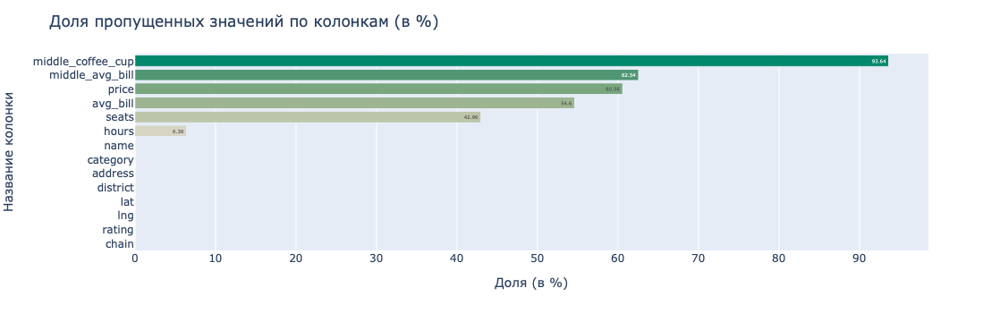

In [14]:
preprocess_data(data)

In [15]:
def check_data(data):
    # Check info
    
    # отбор числовых колонок
    df_numeric = data.select_dtypes(include=[np.number])
    numeric_cols = df_numeric.columns.values
    # отбор нечисловых колонок
    df_non_numeric = data.select_dtypes(exclude=[np.number])
    non_numeric_cols = df_non_numeric.columns.values
    
    print(f"""
    Общая информация о датафрейме:
    
    В датафрейме всего {len(data.columns)} колонок и {len(data)} строк
    
    Колонки хранят следующие типы данных: 
    
    {data.dtypes}
    
    Колонки с числовым типом данных:
    
    {numeric_cols}
    
    Колонки с нечисловым типом данных:
    
    {non_numeric_cols}
    
    """)
    
    # Check for duplicates
    if data.duplicated().sum() > 0:
        print(f'Количество строк-дубликатов: {data.duplicated().sum()}')
        print(f'Дубликаты составляют {round(data.duplicated().sum()/len(data)*100, 2)} % от всех данных')
    else:
        print('Дубликаты отсутствуют')
    
    # Check for NaN-values
    nan = pd.DataFrame((data.isna().mean()*100).round(2).sort_values(ascending=False)).reset_index()
    nan.columns = ['name', '%_of_nan_values']
    
    if sum(nan['%_of_nan_values']) == 0:
        print('Пропуски отсутствуют')
    
    else:
        print('В данных есть пропущенные значения')
        
        colors = ['#00876c', '#509673', '#7aa680', '#9db591', '#bcc5a8', '#d6d5c3', '#ebe8e0', '#e2d2ba', '#deba97', '#dca079', '#db8463', '#d96455', '#d43d51']
        
        # строим столбчатую диаграмму 
        fig = px.bar(nan.sort_values(by='%_of_nan_values', ascending=False),
                     x='%_of_nan_values', # указываем столбец с данными для оси X
                     y='name', # указываем столбец с данными для оси Y
                     color='name',
                     color_discrete_sequence=colors,
                     text='%_of_nan_values'
                    )
        # оформляем график
        fig.update_layout(title='Доля пропущенных значений по колонкам (в %)',
                          xaxis_title='Доля (в %)',
                          yaxis_title='Название колонки',
                          showlegend=False)
        fig.show() # выводим график
     


    Общая информация о датафрейме:
    
    В датафрейме всего 14 колонок и 8406 строк
    
    Колонки хранят следующие типы данных: 
    
    name                  object
category              object
address               object
district              object
hours                 object
lat                  float64
lng                  float64
rating               float64
price                 object
avg_bill              object
middle_avg_bill      float64
middle_coffee_cup    float64
chain                  int64
seats                float64
dtype: object
    
    Колонки с числовым типом данных:
    
    ['lat' 'lng' 'rating' 'middle_avg_bill' 'middle_coffee_cup' 'chain'
 'seats']
    
    Колонки с нечисловым типом данных:
    
    ['name' 'category' 'address' 'district' 'hours' 'price' 'avg_bill']
    
    
Дубликаты отсутствуют
В данных есть пропущенные значения


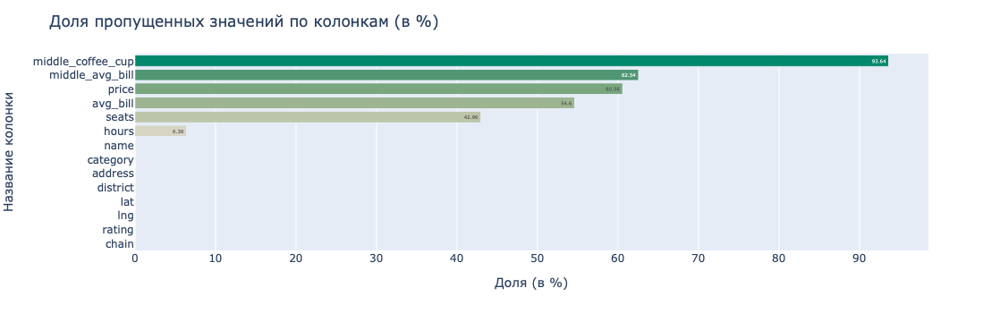

In [16]:
check_data(data)

**Вывод**

Типы данных в колонках указаны корректно.

Дубликаты отсутствуют. Необходимо проверить датасет на неявные дубликаты.

Есть пропущенные значения: 
- в колонках с числовым типом данных 'middle_avg_bill', 'middle_coffee_cup', 'seats' пропущенные значения заполним "заглушкой" с числом -999
- пропущенные значения в категориальных колонках 'price', 'avg_bill', 'hours' заполним "заглушкой" - '_MISSING_'

Далее необходимо выполнить предобработку данных и проверить датасет на неявные дубликаты.

### Предобработка данных

#### Проверка данных на неявные дубликаты

Проверим данные на неявные дубликаты по столбцам name и address:

In [21]:
#приведем столбец name к нижнему регистру
data['name']=data['name'].str.lower()
#посчитаем кол-во неявных дубликатов
duplicated_sum=data[['name', 'address']].duplicated().sum()
print(f'Количество неявных дубликатов в датасете: {duplicated_sum}')
#выведем строки с неявными дубликатами
data[data[['name', 'address']].duplicated()]

Количество неявных дубликатов в датасете: 3


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1511,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
2420,раковарня клешни и хвосты,"бар,паб","Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0
3109,хлеб да выпечка,кафе,"Москва, Ярцевская улица, 19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0


В данных присутствует 3 неявных дубликата, рассмотрим каждый из них подробнее и решим, что с ними делать:

In [23]:
data[data['name']=='раковарня клешни и хвосты']

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2211,раковарня клешни и хвосты,ресторан,"Москва, проспект Мира, 118",Северо-Восточный административный округ,"ежедневно, 12:00–00:00",55.810553,37.638161,4.4,NaN,NaN,NaN,NaN,0,150.0
2420,раковарня клешни и хвосты,"бар,паб","Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0
7270,раковарня клешни и хвосты,"бар,паб","Москва, Братиславская улица, 12",Юго-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.659744,37.752984,4.9,средние,Цена бокала пива:150–250 ₽,NaN,NaN,1,40.0


Дубликаты с наименованием 'Раковарня клешни и хвосты' отличаются режимом работы, категорией и отнесением к сетевому/несетевому заведению. Такое бывает, когда при ресторане работает отдельно бар, удалять не будем.

In [25]:
data[data['name']=='хлеб да выпечка']

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
3091,хлеб да выпечка,булочная,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738886,37.411648,4.1,NaN,NaN,NaN,NaN,1,276.0
3109,хлеб да выпечка,кафе,"Москва, Ярцевская улица, 19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0
7937,хлеб да выпечка,кофейня,"Москва, Каширское шоссе, 61Г",Южный административный округ,"ежедневно, 09:00–22:00",55.621379,37.714108,4.5,NaN,NaN,NaN,NaN,1,NaN


Дубликаты с наименованием 'хлеб да выпечка' отличаются режимом работы, категорией и отнесением к сетевому/несетевому заведению. Возможно при булочной отдельно работает кафе, не удаляем.

In [27]:
data[data['name']=='more poke']

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1430,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,0,188.0
1511,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
6088,more poke,ресторан,"Москва, Духовской переулок, 19",Южный административный округ,"ежедневно, 10:00–22:00",55.704177,37.612889,4.4,NaN,NaN,NaN,NaN,1,NaN


Дубликаты с наименованием 'More Poke' отличаются режимом работы и отнесением к сетевому/несетевому заведению.
Можно было бы удалить один из них, но неизвестно точно, относится ли это заведение к сетевому или нет, а также это не повлияет на общую картину данных, поэтому данные заведения оставим.

#### Заполнение пропусков

In [30]:
# категориальные признаки
col_non_numeric = ['price', 'avg_bill', 'hours']

for column in col_non_numeric:
    data[column]=data[column].fillna('_MISSING_')

In [31]:
# численные признаки
col_numeric = ['middle_avg_bill', 'middle_coffee_cup', 'seats']

for column in col_numeric:
    data[column]=data[column].fillna(-999)  

In [32]:
nan = pd.DataFrame((data.isna().mean()*100).round(2).sort_values(ascending=False)).reset_index()
nan.columns = ['name', '%_of_nan_values']
    
if sum(nan['%_of_nan_values']) == 0:
    print('Пропуски отсутствуют')
else:
    print('В данных есть пропущенные значения')

Пропуски отсутствуют


#### Создание столбца street

Создадим столбец street с названиями улиц из столбца с адресом:

In [35]:
data['street'] = data['address'].str.split(',', expand=True)[1]

#### Создание столбца is_24/7

Создадим столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7):
- логическое значение True — если заведение работает ежедневно и круглосуточно;
- логическое значение False — в противоположном случае.

In [38]:
#напишем функцию для категоризации значений
def categorize_hours(hours):
    if hours == 'ежедневно, круглосуточно':
        return True
    else:
        return False

In [39]:
#применим функцию к столбцу hours
data['is_24/7'] = data['hours'].apply(categorize_hours)

### Вывод

In [41]:
#посмотрим на обновленный датафремй
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,_MISSING_,_MISSING_,-999.0,-999.0,0,-999.0,улица Дыбенко,False
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,-999.0,0,4.0,улица Дыбенко,False
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,-999.0,0,45.0,Клязьминская улица,False
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,_MISSING_,Цена чашки капучино:155–185 ₽,-999.0,170.0,0,-999.0,улица Маршала Федоренко,False
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,-999.0,1,148.0,Правобережная улица,False


Была проведена следующая предобратока данных:
- типы данных в колонках указаны корректно
- дубликаты отсутствуют
- в колонках с числовым типом данных 'middle_avg_bill', 'middle_coffee_cup', 'seats' пропущенные значения заполнены "заглушкой" с числом -999
- пропущенные значения в категориальных колонках 'price', 'avg_bill', 'hours' заполнены "заглушкой" - '_MISSING_'
- создан столбец street с названиями улиц из столбца с адресом
- создан столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7):
        - логическое значение True — если заведение работает ежедневно и круглосуточно
        - логическое значение False — в противоположном случае
        
*Предобработка данных завершена*

## Исследовательский анализ данных

### Исследование количества объектов общественного питания по категориям

Исследуем количество объектов общественного питания по категориям:

In [46]:
#подготовим данные
data_by_cat = data.groupby('category', as_index=False).agg({'name':'count'}).sort_values(by='name', ascending=False)
data_by_cat['share']=(data_by_cat['name']/data_by_cat['name'].sum()*100).round(1).astype('str') + '%'
data_by_cat.columns = ['category', 'total_count', 'share']
data_by_cat=pd.concat([data_by_cat], ignore_index=True)
#data_by_cat

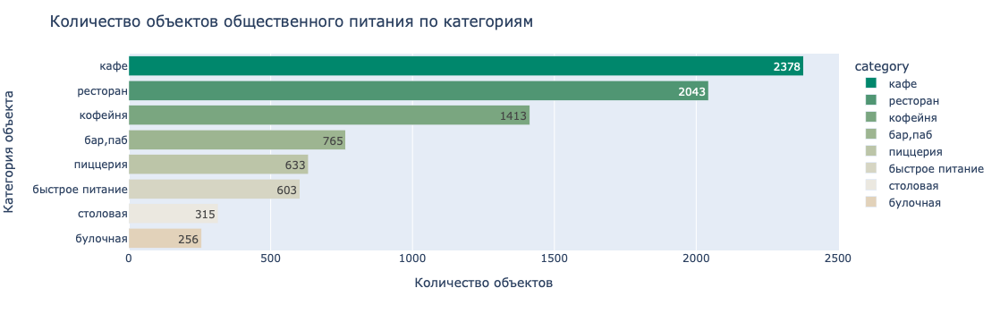

In [47]:
colors = ['#00876c', '#509673', '#7aa680', '#9db591', '#bcc5a8', '#d6d5c3', '#ebe8e0', '#e2d2ba', '#deba97', '#dca079', '#db8463', '#d96455', '#d43d51']


# строим столбчатую диаграмму 
fig = px.bar(data_by_cat.sort_values(by='total_count', ascending=False), # загружаем данные и заново их сортируем
             x='total_count', # указываем столбец с данными для оси X
             y='category', # указываем столбец с данными для оси Y
             color='category',
             color_discrete_sequence=colors,
             text='total_count'
            )
# оформляем график
fig.update_layout(title='Количество объектов общественного питания по категориям',
                   xaxis_title='Количество объектов',
                   yaxis_title='Категория объекта')

fig.show() # выводим график

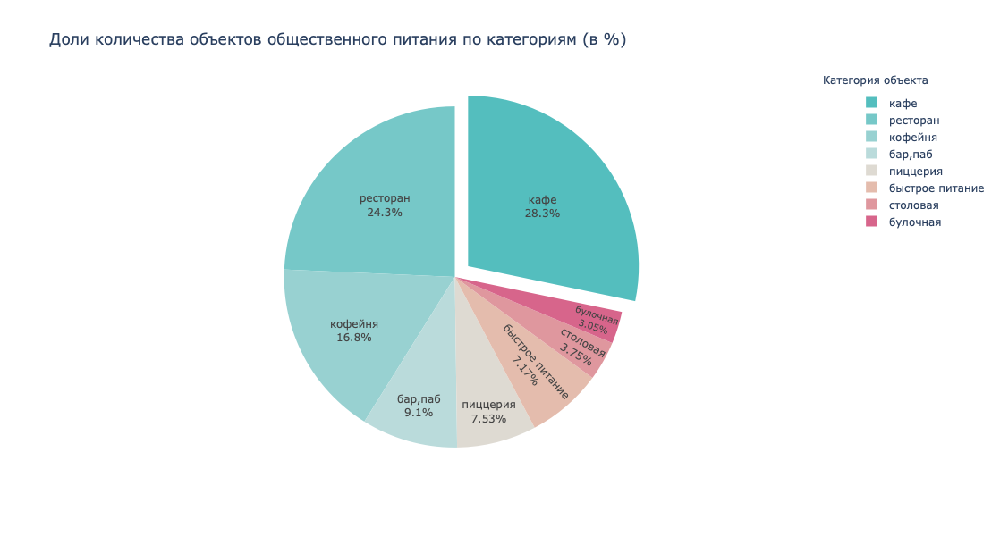

In [48]:
colors_fr = ["#54bebe", "#76c8c8", "#98d1d1", "#badbdb", "#dedad2", "#e4bcad", "#df979e", "#d7658b", "#c80064"]

data_by_cat2 = pd.DataFrame(data['category'].value_counts()).reset_index()

# строим диаграмму с сегментами
fig = go.Figure(data=[go.Pie(labels=data_by_cat2['category'], # указываем значения, которые появятся на метках сегментов
                             values=data_by_cat2['count'], # указываем данные, которые отобразятся на графике 
                             pull = [0.1, 0])])

fig.update_layout(title='Доли количества объектов общественного питания по категориям (в %)', # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=600,
                  annotations=[dict(x=1.12, # вручную настраиваем аннотацию легенды
                                    y=1.05,
                                    text='Категория объекта',
                                    showarrow=False)])
fig.update_traces(textposition='inside', textinfo='percent+label', marker=dict(colors=colors_fr))
fig.show() # выводим график

**Вывод:**

- в датафрейме больше всего объектов категории "кафе" - 2378 шт., или 28,3%
- на втором месте категория "ресторан" - 2043 объекта (24,3%)
- далее идут кофейни (16,8%) - 1413 объектов в этой категории
- четвертое место - "бар,паб" с 9,1% (765 шт.)
- пятое место занимают объекты в категории "пиццерия" - всего 633 шт.(7,53%)
- последние три места по количеству объектов занимают категории быстрое питание (7%), столовая (3,7%), булочная (3%).

### Исследование количества посадочных мест в объектах общественного питания по категориям

Исследуем количество посадочных мест в объектах по категориям.

In [52]:
#подготовим данные
data_by_seats = data[data['seats']!= -999] #убираем заглушку
data_by_seats = data_by_seats.groupby('category', as_index=False).agg({'seats':'sum'}).sort_values(by='seats', ascending=False)
data_by_seats['share']=(data_by_seats['seats']/data_by_seats['seats'].sum()*100).round(1).astype('str') + '%'
data_by_seats.columns = ['category', 'count_seats', 'share']
data_by_seats['count_seats']=data_by_seats['count_seats'].astype(int)
data_by_seats=pd.concat([data_by_seats], ignore_index=True)
data_by_seats

,category,count_seats,share
0,ресторан,154869,29.8%
1,кафе,118770,22.8%
2,кофейня,83511,16.1%
3,"бар,паб",58281,11.2%
4,пиццерия,40350,7.8%
5,быстрое питание,34513,6.6%
6,столовая,16359,3.1%
7,булочная,13229,2.5%


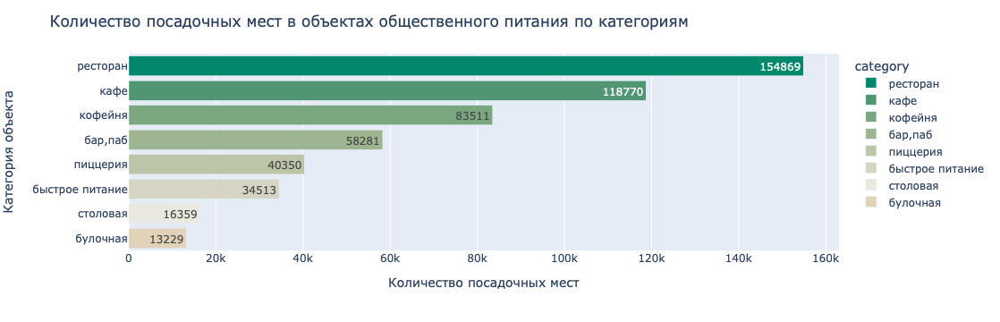

In [53]:
# строим столбчатую диаграмму 
fig = px.bar(data_by_seats.sort_values(by='count_seats', ascending=False), # загружаем данные и заново их сортируем
             x='count_seats', # указываем столбец с данными для оси X
             y='category', # указываем столбец с данными для оси Y
             color='category',
             color_discrete_sequence=colors,
             text='count_seats'
            )
# оформляем график
fig.update_layout(title='Количество посадочных мест в объектах общественного питания по категориям',
                   xaxis_title='Количество посадочных мест',
                   yaxis_title='Категория объекта')

fig.show() # выводим график

Тройка лидеров по количеству посадочных мест выглядит так: 
- в категории "ресторан" всего 154 869 посадочных мест
- кафе насчитывают 118770 мест
- в кофейнях всего 83511 посадочных места

Меньше всего посадочных мест в категориях быстрое питание, столовая, булочная.

Стоит также рассчитать среднее количество посадочных мест на каждую из категорий заведения:

In [56]:
#подготовим данные
data_by_seats1 = data[data['seats']!= -999]
data_by_seats1 = data_by_seats1.groupby('category', as_index=False).agg({'seats':'median'})
data_by_seats1 = data_by_seats1.sort_values(by='seats',ascending=False)

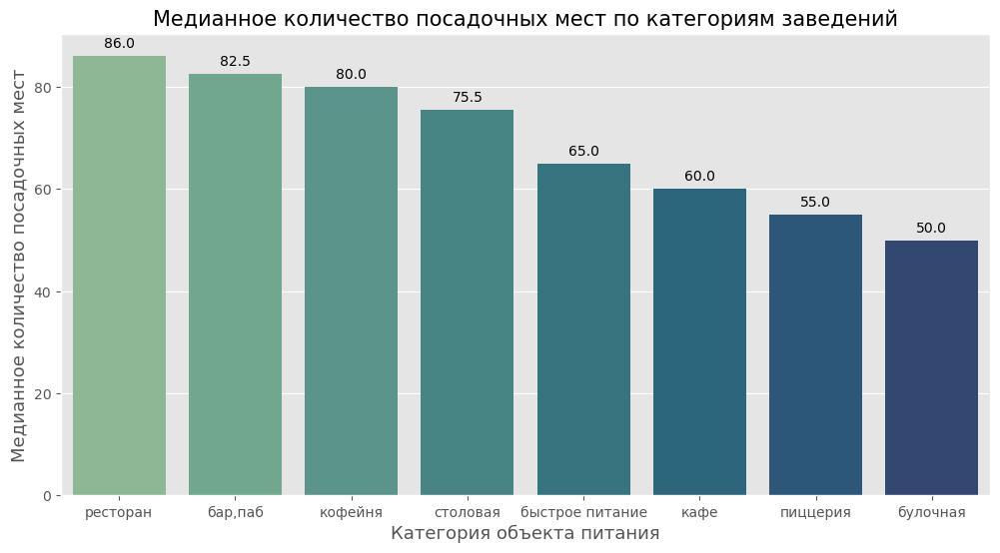

In [57]:
#построим график
plt.figure(figsize=(12,6))

ax = sns.barplot(data=data_by_seats1, x='category', y='seats', palette = 'crest')
for g in ax.patches:
    ax.annotate(format(g.get_height(), '.1f'),
                   (g.get_x() + g.get_width() / 2., g.get_height()),
                   ha = 'center', va = 'center',
                   xytext = (0, 9),
                   textcoords = 'offset points')
plt.title('Медианное количество посадочных мест по категориям заведений', size = 15)
plt.xlabel('Категория объекта питания', size = 13)
plt.ylabel('Медианное количество посадочных мест', size = 13)
plt.show()

**Вывод:**

- самое большое медианное количество посадочных мест наблюдается в категории "ресторан" - 86 мест.
- далее идет категория "бар, паб" - 82,5 мест.
- на третьем месте категория "кофейня" с 80 посадочными местами.

Категория кафе со второго места опустилась на шестое - медианное количество посадочных мест на заведение - 60.

Самое низкое медианное число посадочных мест в категориях "пиццерия" и "булочная".

### Исследование соотношения сетевых и несетевых заведений в датасете

Рассмотрим соотношение сетевых и несетевых заведений в датасете:

In [61]:
#подготовим данные
data_by_chain = data.groupby('chain', as_index=False).agg(count=('name', 'count'))
data_by_chain['chain'] = data_by_chain['chain'].replace(0, 'несетевые')
data_by_chain['chain'] = data_by_chain['chain'].replace(1, 'сетевые')

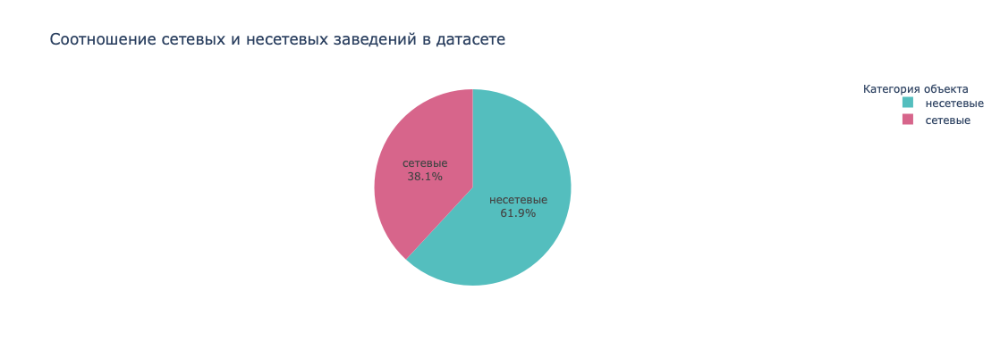

In [62]:
colors2 = ["#54bebe", "#d7658b"]

# строим диаграмму с сегментами
fig = go.Figure(data=[go.Pie(labels=data_by_chain['chain'], # указываем значения, которые появятся на метках сегментов
                             values=data_by_chain['count'])])# указываем данные, которые отобразятся на графике 

fig.update_layout(title='Cоотношение сетевых и несетевых заведений в датасете', # указываем заголовок графика
                  width=600, # указываем размеры графика
                  height=400,
                  annotations=[dict(x=1.12, # вручную настраиваем аннотацию легенды
                                    y=1.05,
                                    text='Категория объекта',
                                    showarrow=False)])
fig.update_traces(textposition='inside', textinfo='percent+label', marker=dict(colors=colors2))
fig.show() # выводим график

In [63]:
print(f"""
Количество сетевых заведений в датасете: {data_by_chain.iloc[1]['count']}
Количество несетевых заведений в датасете: {data_by_chain.iloc[0]['count']}
""")


Количество сетевых заведений в датасете: 3205
Количество несетевых заведений в датасете: 5201



**В датасете больше несетевых заведений - 62%, против 38% сетевых заведений.**

Исследуем, какие категории заведений чаще являются сетевыми:

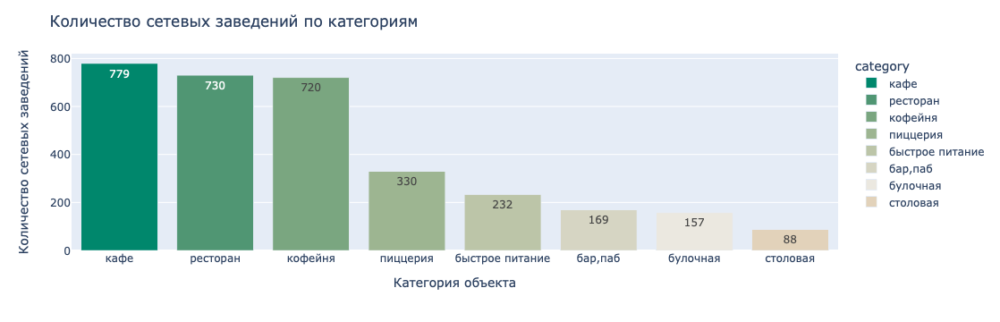

In [66]:
#подготовим данные
data_chain=data[data['chain'] == 1].groupby('category', as_index=False).agg(chain=('name', 'count')).sort_values(by='chain', ascending=False)

# строим столбчатую диаграмму 
fig = px.bar(data_chain, # загружаем данные
             x='category', # указываем столбец с данными для оси X
             y='chain', # указываем столбец с данными для оси Y
             color='category',
             color_discrete_sequence=colors,
             text='chain'# добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Количество сетевых заведений по категориям',
                   xaxis_title='Категория объекта',
                   yaxis_title='Количество сетевых заведений')

fig.show() # выводим график

По количеству объектов в датафрейме больше всего сетевых заведений в категориях кафе (779 об.), ресторан (730 об.), кофейня (720 об.).

Построим график доли сетевых заведений от всех заведений по категориям:

In [69]:
#подготовим данные
data_chain2 = data[data['chain'] == 1].groupby('category', as_index=False).agg(chain=('name', 'count')).sort_values(by='chain', ascending=False)
data_not_chain = data[data['chain'] == 0].groupby('category').agg(not_chain=('name', 'count')).sort_values(by='not_chain', ascending=False)
data_by_chain2 = pd.merge(data_chain2, data_not_chain, on='category')
data_by_chain2['total_count']=data_by_chain2['chain']+data_by_chain2['not_chain']
data_by_chain2['chain, %'] = round(data_by_chain2['chain']/data_by_chain2['total_count']*100, 1)
data_by_chain2['not_chain, %'] = round(data_by_chain2['not_chain']/data_by_chain2['total_count']*100, 1)
column_order=['category', 'chain', 'chain, %', 'not_chain', 'not_chain, %', 'total_count']
data_by_chain2 = data_by_chain2[column_order]
data_by_chain2.sort_values(by='total_count',ascending=False)

,category,chain,"chain, %",not_chain,"not_chain, %",total_count
0,кафе,779,32.8,1599,67.2,2378
1,ресторан,730,35.7,1313,64.3,2043
2,кофейня,720,51.0,693,49.0,1413
5,"бар,паб",169,22.1,596,77.9,765
3,пиццерия,330,52.1,303,47.9,633
4,быстрое питание,232,38.5,371,61.5,603
7,столовая,88,27.9,227,72.1,315
6,булочная,157,61.3,99,38.7,256


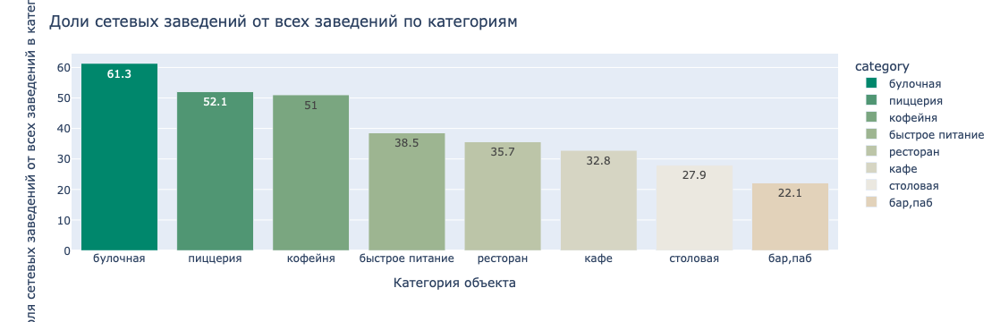

In [70]:
#подготовим данные
data_by_chain2=data_by_chain2.sort_values(by='chain, %', ascending=False)

# строим столбчатую диаграмму 
fig = px.bar(data_by_chain2, # загружаем данные
             x='category', # указываем столбец с данными для оси X
             y='chain, %', # указываем столбец с данными для оси Y
             color='category',
             color_discrete_sequence=colors,
             text='chain, %'# добавляем аргумент, который отобразит текст с информацией
                                # о количестве объявлений внутри столбца графика
            )
# оформляем график
fig.update_layout(title='Доли сетевых заведений от всех заведений по категориям',
                   xaxis_title='Категория объекта',
                   yaxis_title='Доля сетевых заведений от всех заведений в категории')

fig.show() # выводим график

**Вывод:**

- в датасете больше несетевых заведений - 5201 или 62%, против 38% (3205 об.) сетевых заведений.
- по количеству объектов в датафрейме больше всего сетевых заведений в категориях кафе (779 об.), ресторан (730 об.), кофейня (720 об.).
- самая большая доля сетевых заведений наблюдается в категории "булочная" - сетевые заведения составляют 61% от всех заведений.
- далее идут пиццерии - 52% являются сетевыми
- 51% от всех кофеен в датафрейме - сетевые. третье место
- меньше всего сетевых заведений в категориях "кафе" (32%), "столовая" (28%), "бар, паб" (22%).

### Топ-15 популярных сетей в Москве

Найдем топ-15 популярных сетей в Москве (по количеству точек):

In [74]:
#подготовим данные
data_by_name = data[data['chain'] == 1]
data_by_name = data_by_name.groupby('name', as_index=False).agg(count=('name', 'count')).sort_values(by='count', ascending=False).head(15)
data_by_name=pd.concat([data_by_name], ignore_index=True)
#data_by_name

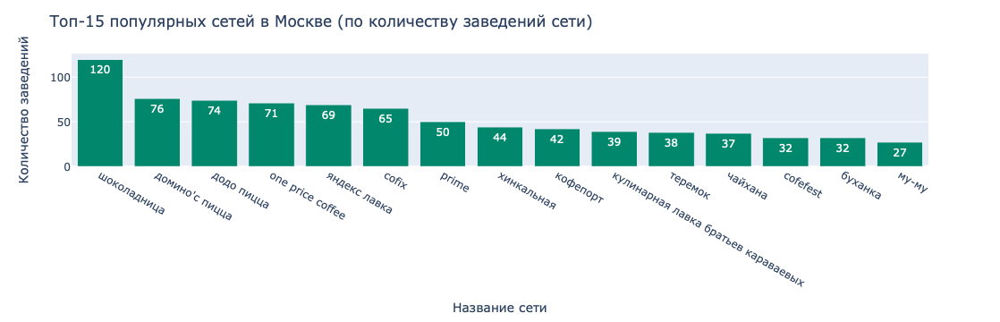

In [75]:
colors3 = ['#00876c']

# строим столбчатую диаграмму 
fig = px.bar(data_by_name, # загружаем данные
             x='name', # указываем столбец с данными для оси X
             y='count', # указываем столбец с данными для оси Y
             color='name',
             color_discrete_sequence=colors3,
             text='count'
            )
# оформляем график
fig.update_layout(title='Топ-15 популярных сетей в Москве (по количеству заведений сети)',
                  xaxis_title='Название сети',
                  yaxis_title='Количество заведений',
                  showlegend=False)

fig.show() # выводим график

Топ-15 выглядит достаточно правдоподобно - все эти заведения большие, известные сети, пользующиеся популярностью. 

Посмотрим к каким категориям относятся популярные сетевые заведения:

In [78]:
#подготовим данные
data_by_name1=data[data.chain == 1].groupby(['name', 'category'], as_index=False).agg(count=('name', 'count'))
data_by_name1=data_by_name1.sort_values(by='count',ascending=False)
top15=pd.merge(data_by_name, data_by_name1, on='name')
top15=top15.drop(columns = ['count_x'],axis = 1)
top15.columns=['name', 'category', 'count_name']
#top15.groupby(['category', 'name']).agg(count=('count_name', 'sum'))

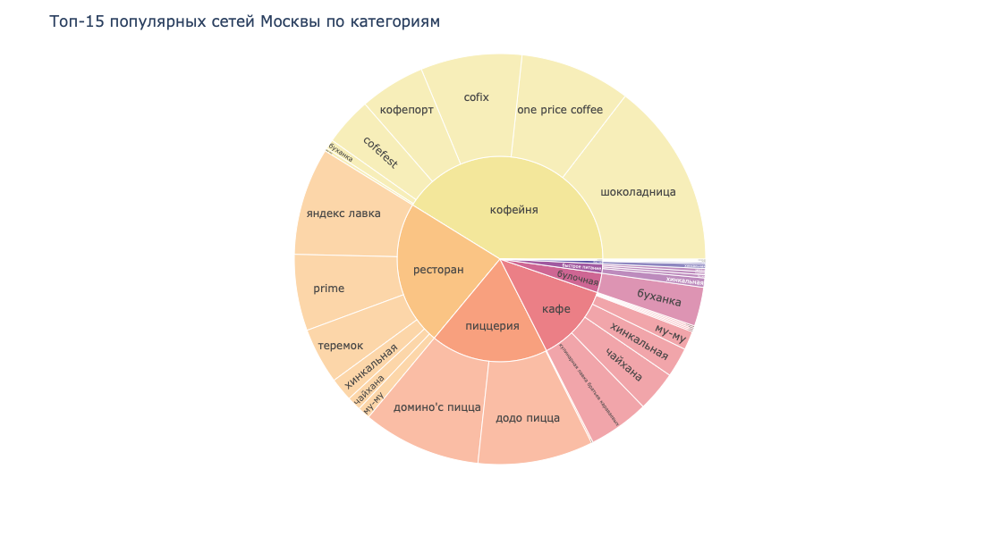

In [79]:
#построим график
fig = px.sunburst(top15, path=['category', 'name'], values='count_name',
                  color_discrete_sequence=px.colors.sequential.Sunset)
# оформляем график
fig.update_layout(title='Топ-15 популярных сетей Москвы по категориям', # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=600)
fig.show()

In [80]:
#создадим датафрейм c 15-топ улиц
top15_name = top15['name']
name_top15_list = top15_name.values.tolist()
data_top15_name=data.query('name in @name_top15_list')

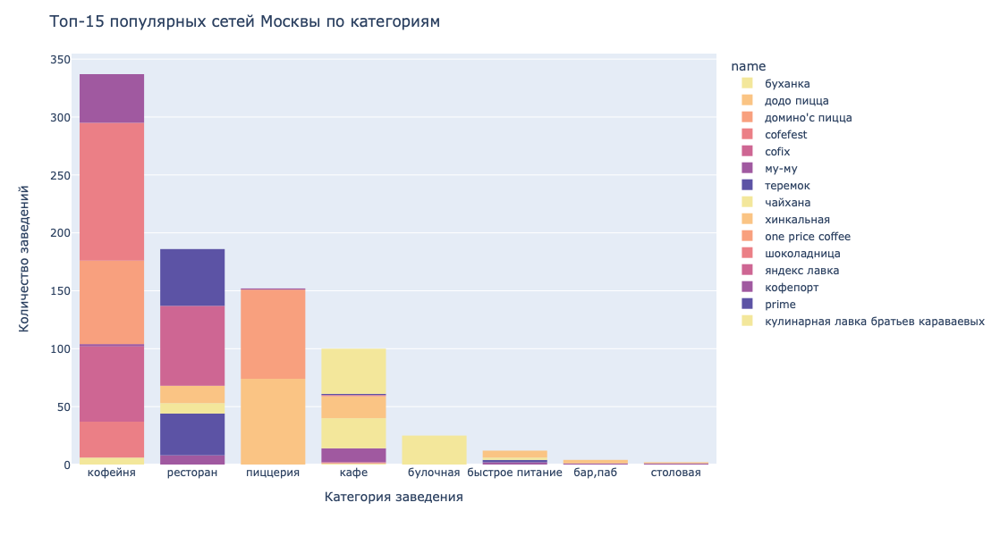

In [81]:
#построим график
fig = px.histogram(data_top15_name,
                   x='category',
                   color='name',
                   color_discrete_sequence=px.colors.sequential.Sunset).update_xaxes(categoryorder='total descending')
# оформляем график
fig.update_layout(title='Топ-15 популярных сетей Москвы по категориям', # указываем заголовок графика
                  xaxis_title='Категория заведения',
                  yaxis_title='Количество заведений',
                  width=1000, # указываем размеры графика
                  height=600)

fig.show()

In [82]:
top15_gr=top15.groupby('category').agg(count=('count_name', 'sum')).reset_index()
top15_gr=top15_gr.sort_values(by='count',ascending=False)
top15_gr

,category,count
4,кофейня,336
6,ресторан,186
5,пиццерия,151
3,кафе,100
1,булочная,25
2,быстрое питание,12
0,"бар,паб",4
7,столовая,2


**Вывод:**

В топ-15 популярных сетей в Москве (по количеству заведений сети) входят крупные и известные сети, такие как:
'Шоколадница', "Домино'с Пицца", 'Додо Пицца', 'One Price Coffee', 'Яндекс Лавка', 'Cofix', 'Prime', 'Хинкальная', 'КОФЕПОРТ', 'Кулинарная лавка братьев Караваевых', 'Теремок', 'Чайхана', 'CofeFest', 'Буханка', 'Му-Му'.

Исходя из графика, самые популярные категории, характерные для топ-15 (по количеству точек) сетевых заведений Москвы, такие:
- кофейня (336 объектов)
- ресторан (186 об.)
- пиццерия (151 об.)
- кафе (100 об.)

Также стоит обратить внимание на то, что некоторые сетевые заведения причисляют себя к нескольким категориям, например, у сети Чайхана 26 точек открыто в категории кафе, 9 в категории ресторан и 2 точки в категории общественное питание. Разделение также присутсвует у сетей Шоколадница, Prime, Хинкальная, Теремок, CofeFest, Буханка и Му-Му.

### Количество заведений по районам Москвы

Посмотрим, какие административные районы присутствуют в датасете и посчитаем количество заведений в каждом районе:

In [86]:
#готовим данные
data_by_district = data.groupby('district').agg(count=('name', 'count')).sort_values(by='count', ascending=False)
data_by_district['share']=round(data_by_district['count']/sum(data_by_district['count'])*100, 1)
data_by_district=data_by_district.reset_index()
#data_by_district

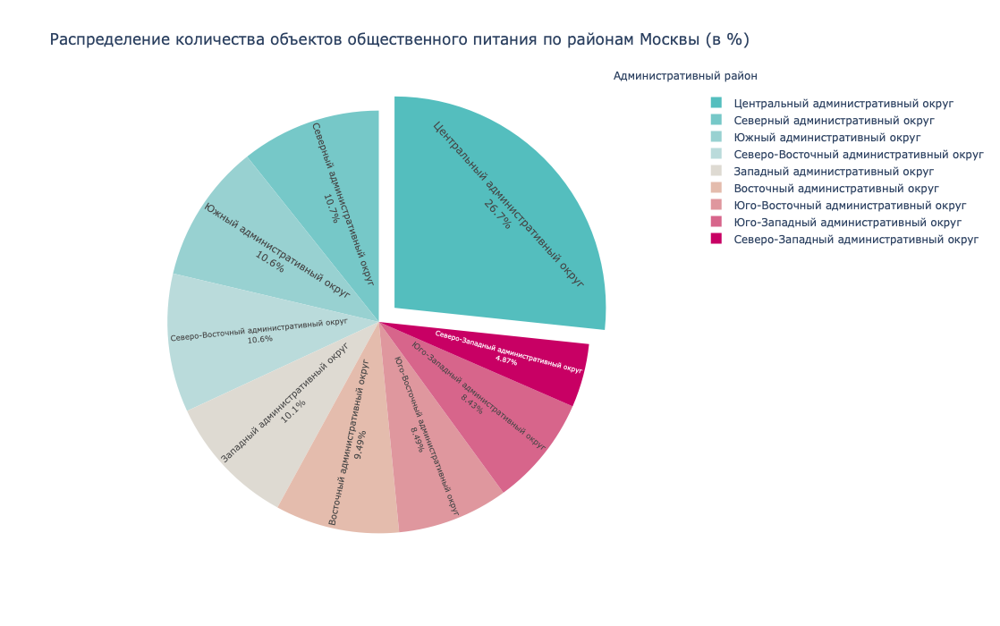

In [87]:
# строим диаграмму с сегментами
fig = go.Figure(data=[go.Pie(labels=data_by_district['district'], # указываем значения, которые появятся на метках сегментов
                             values=data_by_district['count'], # указываем данные, которые отобразятся на графике 
                             pull = [0.1, 0])])

fig.update_layout(title='Распределение количества объектов общественного питания по районам Москвы (в %)', # указываем заголовок графика
                  width=900, # указываем размеры графика
                  height=700,
                  annotations=[dict(x=1.12, # вручную настраиваем аннотацию легенды
                                    y=1.05,
                                    text='Административный район',
                                    showarrow=False)])
fig.update_traces(textposition='inside', textinfo='percent+label', marker=dict(colors=colors_fr))
fig.show() # выводим график

Построим гистограмму, отражающую общее количество заведений и количество заведений каждой категории по районам:

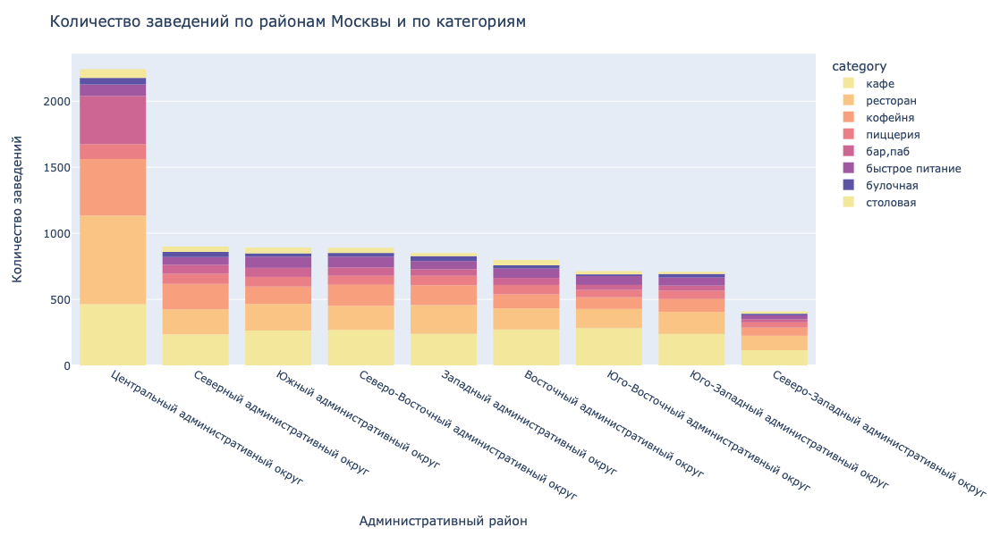

In [89]:
#построим график
fig = px.histogram(data,
                   x='district',
                   color='category',
                   color_discrete_sequence=px.colors.sequential.Sunset).update_xaxes(categoryorder='total descending')
# оформляем график
fig.update_layout(title='Количество заведений по районам Москвы и по категориям', # указываем заголовок графика
                  xaxis_title='Административный район',
                  yaxis_title='Количество заведений',
                  width=1000, # указываем размеры графика
                  height=600)

fig.show()

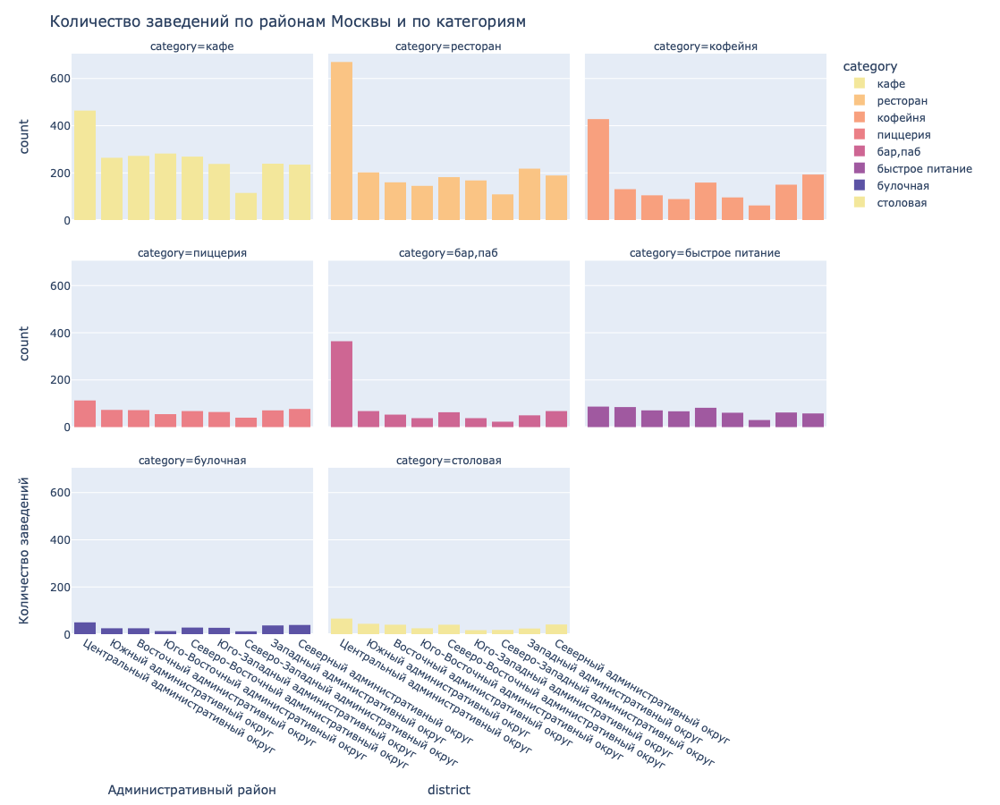

In [90]:
#построим график
fig = px.histogram(data,
                   x='district',
                   color='category',
                   facet_col='category',
                   facet_col_wrap=3,
                   color_discrete_sequence=px.colors.sequential.Sunset).update_xaxes(categoryorder='total ascending')
# оформляем график
fig.update_layout(title='Количество заведений по районам Москвы и по категориям', # указываем заголовок графика
                  xaxis_title='Административный район',
                  yaxis_title='Количество заведений',
                  width=900, # указываем размеры графика
                  height=900)
fig.show()

**Вывод**

Больше всего заведений находится в ЦАО - 2242 объекта (26,7%), далее идут 4 района с примерно одинаковым количеством объектов (в районе 10-11% от всех) - САО, ЮАО, СВАО, ЗАО. Меньше всего объектов находится в СЗАО - всего 409 (4,9%).

Из гистограмм мы видим, что распределение категорий заведений по районам примерно одинаково - на первых трех местах стабильно находятся категории кафе, ресторан и кофейня. Рестораны занимают первое место по количеству только в районе ЦАО. В других районах на первых местах чаще заведения категории кафе. Кофейни во всех районах занимают третье место по количеству точек.

### Распределение средних рейтингов по категориям заведений

Визуализируем распределение средних рейтингов по категориям заведений:

In [94]:
#подготовим данные
data_by_rating = data.groupby('category').agg({'rating':'mean'}).sort_values(by='rating',ascending=False)
data_by_rating=data_by_rating.reset_index()
#data_by_rating

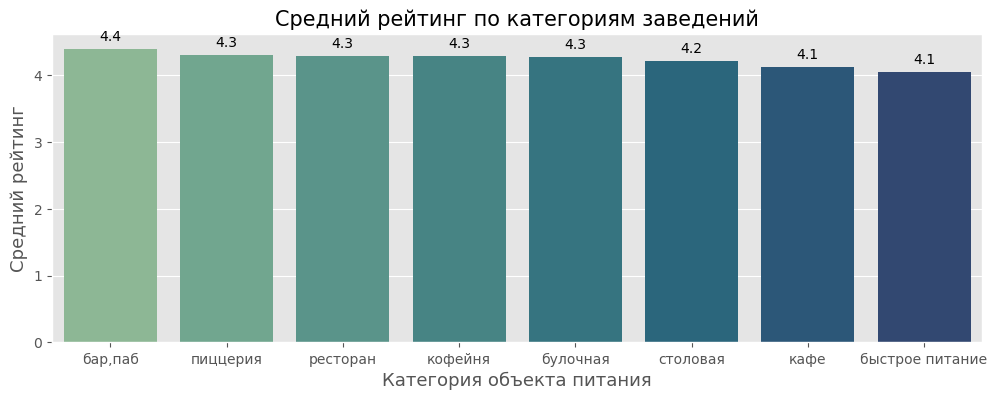

In [95]:
#построим график
plt.figure(figsize=(12,4))

ax = sns.barplot(data=data_by_rating, x='category', y='rating', palette = 'crest')
for g in ax.patches:
    ax.annotate(format(g.get_height(), '.1f'),
                   (g.get_x() + g.get_width() / 2., g.get_height()),
                   ha = 'center', va = 'center',
                   xytext = (0, 9),
                   textcoords = 'offset points')
plt.title('Средний рейтинг по категориям заведений', size = 15)
plt.xlabel('Категория объекта питания', size = 13)
plt.ylabel('Средний рейтинг', size = 13)
plt.show()

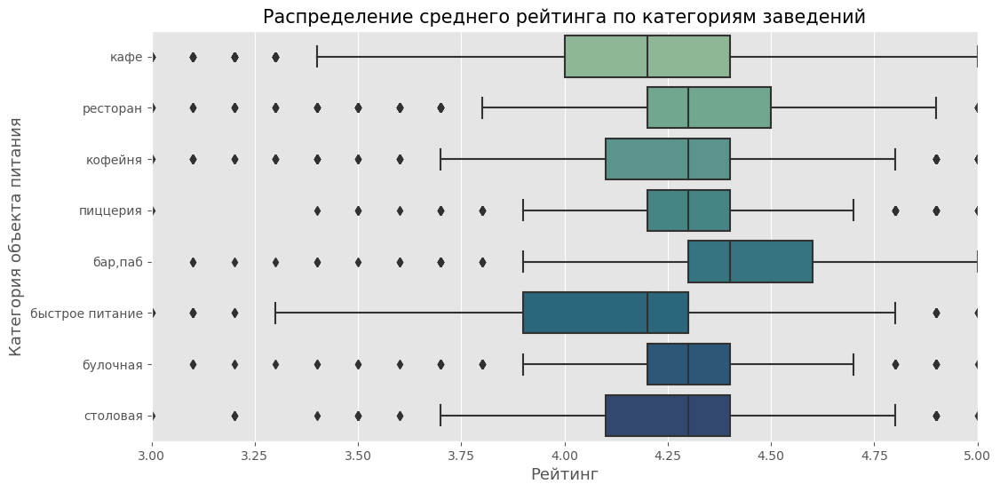

In [96]:
plt.figure(figsize=(12,6))
df5 = sns.boxplot(data=data, x='rating', y='category', palette='crest')
df5.set(xlim=(3,5))
plt.title('Распределение среднего рейтинга по категориям заведений', size = 15)
plt.xlabel('Рейтинг', size = 13)
plt.ylabel('Категория объекта питания', size = 13)
plt.show()

**Вывод**

Усредненный рейтинг по разным типах общепита не сильно отличается - от 4,4 у баров/пабов до 4,1 у быстрого питания.

Графики boxplot подтверждает эти данные - лучше всех себя показывают заведения категории "бар, паб", заведения других категорий - "ресторан", "кафе", "кофейня", "пиццерия", "булочная" - показывают примерно одинаковые результаты. Хуже других распределение рейтинга у заведений категорий "быстрое питание" и "столовая."

### Построение фоновой картограммы (хороплет) со средним рейтингом заведений каждого района Москвы

Построим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района:

In [100]:
rating_data = data.groupby('district', as_index=False)['rating'].agg('median')
#rating_data

In [101]:
# загружаем JSON-файл с границами округов Москвы
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m_rating = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_data,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Oranges',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m_rating)

# выводим карту
m_rating

**Вывод:**

Из построенной фоновой картограммы мы видим, что самый высокий медианный рейтинг - у заведений в центре Москвы (4,4 балла). Самый низкий - у объектов, находящихся в СВАО и ЮВАО (4,2 балла). У заведений в остальных районах медианный рейтинг примерно одинаков и составляет 4,3 балла.

### Отображение всех заведений датасета на карте с помощью кластеров

Отобразим все заведения датасета на карте с помощью кластеров средствами библиотеки folium:

In [105]:
# создаём карту Москвы
m_all = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m_all)

def create_clusters(row):
    # сохраняем URL-адрес изображения со значком торгового центра с icons8,
    # это путь к файлу на сервере icons8
    icon_url = 'https://img.icons8.com/?size=512&id=611&format=png'  
    # создаём объект с собственной иконкой размером 30x30
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    # создаём маркер с иконкой icon и добавляем его в кластер
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
        icon=icon,
    ).add_to(marker_cluster)

# применяем функцию для создания кластеров к каждой строке датафрейма
data.apply(create_clusters, axis=1)

# выводим карту
m_all

**Вывод**

Отобразили все заведения датасета на карте с помощью библиотеки кластеров и использовли собственную иконку.

### Топ-15 улиц по количеству заведений

Найдем топ-15 улиц по количеству заведений. Построим график распределения количества заведений и их категорий по этим улицам:

In [109]:
#подготовим данные
data_by_street = data.groupby('street', as_index=False).agg(count=('name', 'count')).sort_values(by='count', ascending=False).head(15)
data_by_street=pd.concat([data_by_street], ignore_index=True)
data_by_street

,street,count
0,проспект Мира,184
1,Профсоюзная улица,122
2,проспект Вернадского,108
3,Ленинский проспект,107
4,Ленинградский проспект,95
5,Дмитровское шоссе,88
6,Каширское шоссе,77
7,Варшавское шоссе,76
8,Ленинградское шоссе,70
9,МКАД,65


In [110]:
#создадим датафрейм c 15-топ улиц
street = data_by_street['street']
street_list = street.values.tolist()
data_top15_street=data.query('street in @street_list')

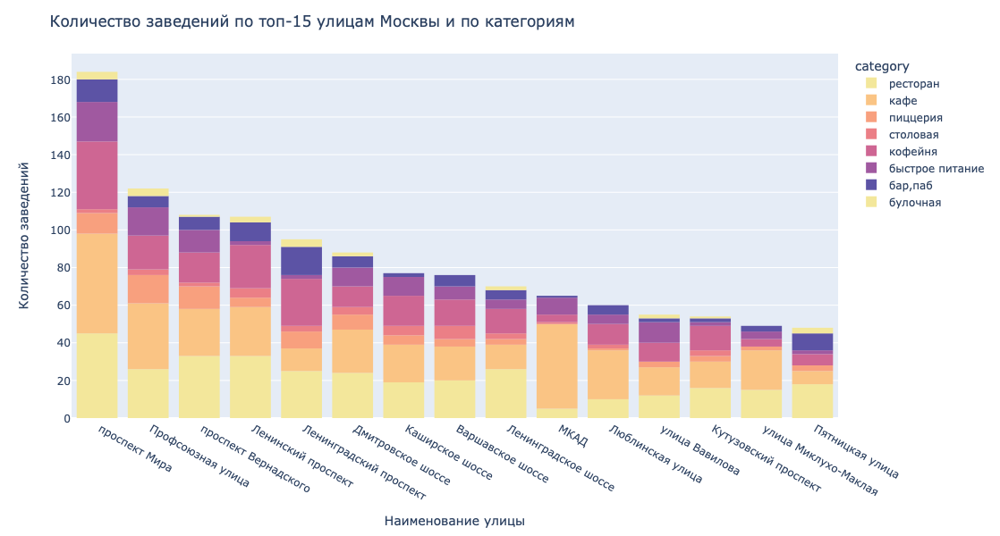

In [111]:
#построим график
fig = px.histogram(data_top15_street,
                   x='street',
                   color='category',
                   color_discrete_sequence=px.colors.sequential.Sunset).update_xaxes(categoryorder='total descending')
# оформляем график
fig.update_layout(title='Количество заведений по топ-15 улицам Москвы и по категориям', # указываем заголовок графика
                  xaxis_title='Наименование улицы',
                  yaxis_title='Количество заведений',
                  width=1000, # указываем размеры графика
                  height=600)

fig.show()

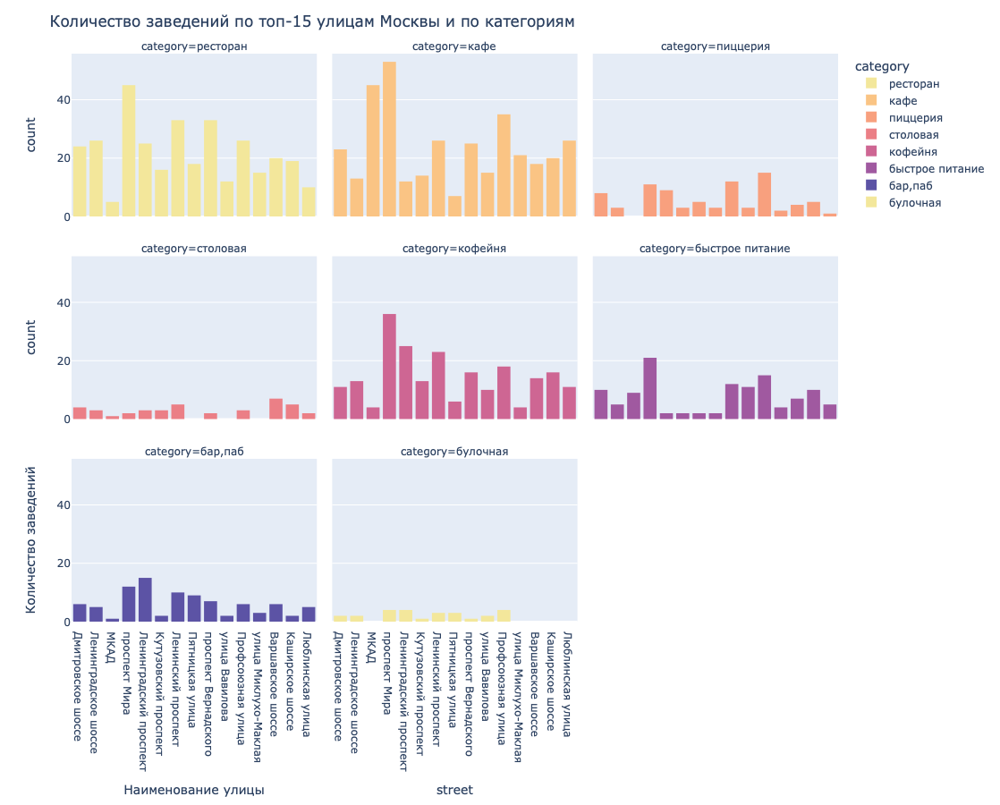

In [112]:
#построим график
fig = px.histogram(data_top15_street,
                   x='street',
                   color='category',
                   facet_col='category',
                   facet_col_wrap=3,
                   color_discrete_sequence=px.colors.sequential.Sunset)
# оформляем график
fig.update_layout(title='Количество заведений по топ-15 улицам Москвы и по категориям', # указываем заголовок графика
                  xaxis_title='Наименование улицы',
                  yaxis_title='Количество заведений',
                  width=900, # указываем размеры графика
                  height=900)
fig.show()

Построим карту, на которой отобразим объекты на топ-15 популярных улиц Москвы:

In [ ]:
# создаём карту Москвы
m_top15 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m_top15)

def create_clusters(row):
    # сохраняем URL-адрес изображения со значком торгового центра с icons8,
    # это путь к файлу на сервере icons8
    icon_url = 'https://img.icons8.com/?size=512&id=611&format=png'  
    # создаём объект с собственной иконкой размером 30x30
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    # создаём маркер с иконкой icon и добавляем его в кластер
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
        icon=icon,
    ).add_to(marker_cluster)

# применяем функцию для создания кластеров к каждой строке датафрейма
data_top15_street.apply(create_clusters, axis=1)

# выводим карту
m_top15

In [267]:
#data_top15_street.groupby('category', as_index=False).agg(count=('name', 'count')).sort_values(by='count', ascending=False)

**Вывод:**

В топ-15 популярных улиц Москвы входят крупные магистрали и шоссе, пронизывающие все районы города.

Самое большое количество объектов (184) находится на проспекте Мира. Далее идут длинные и популярные улицы - Профсоюзная улица (122 об.), проспект Вернадского (108 об.), Ленинский проспект (107 об.), Ленинградский проспект (95 об.). Замыкает топ-15 лидеров Пятницкая улица (48 объектов).  

- Кафе наиболее популярны на топ-15 улицах Москвы (всего 353 об.): больше всего их на проспекте Мира (53 об.), далее идут МКАД (45 об.), Профсоюзная улица (35 об.).
- Потом идет категория рестораны (всего 327 об.) - больше всего ресторанов находится на улицах проспект Мира (45 об.), Ленинский проспект (33 об.), проспект Вернадского (33 об.).
- На третьем месте находятся кофейни (220 об.) - проспект Мира (36 об.), Ленинградский проспект (25 об.), Ленинский проспект (23 об.).
- Меньше всего на топ-15 улицах Москвы открыто столовых (40 об.) и булочных (26 об.).

### Исследование датасета на предмет улиц, на которых находится только один объект общепита

Найдем улицы, на которых находится только один объект общепита:

In [119]:
data_by_street_total = data.groupby('street', as_index=False).agg(count=('name', 'count')).sort_values(by='count', ascending=False)
data_by_street_1=pd.concat([data_by_street_total], ignore_index=True)
data_by_street_1=data_by_street_1[data_by_street_1['count']==1]
#data_by_street_1
print(f'Количество улиц, на которых находится только один объект общепита: {len(data_by_street_1)}, что составляет {round((len(data_by_street_1)/len(data_by_street_total))*100, 1)}% от общего числа улиц в датасете')

Количество улиц, на которых находится только один объект общепита: 458, что составляет 31.6% от общего числа улиц в датасете


In [120]:
#создадим датафрейм, в котором останутся данные по улицам с 1 заведением
street_1 = data_by_street_1['street']
street_1_list = street_1.values.tolist()
data_1_street=data.query('street in @street_1_list')
#data_1_street

Что можно сказать об этих заведениях?

In [122]:
street_1_chain=data_1_street.groupby('chain', as_index=False).agg(count=('name', 'count'))
print(f"""
Количество сетевых заведений: {street_1_chain.iloc[1]['count']} или {round(street_1_chain.iloc[1]['count']/street_1_chain['count'].sum()*100)}%
Количество несетевых заведений: {street_1_chain.iloc[0]['count']} или {round(street_1_chain.iloc[0]['count']/street_1_chain['count'].sum()*100)}%
""")


Количество сетевых заведений: 133 или 29%
Количество несетевых заведений: 325 или 71%



В основном это несетевые заведения - их 71%.

Построим диаграмму, отражающую распределение категорий среди этих объектов:

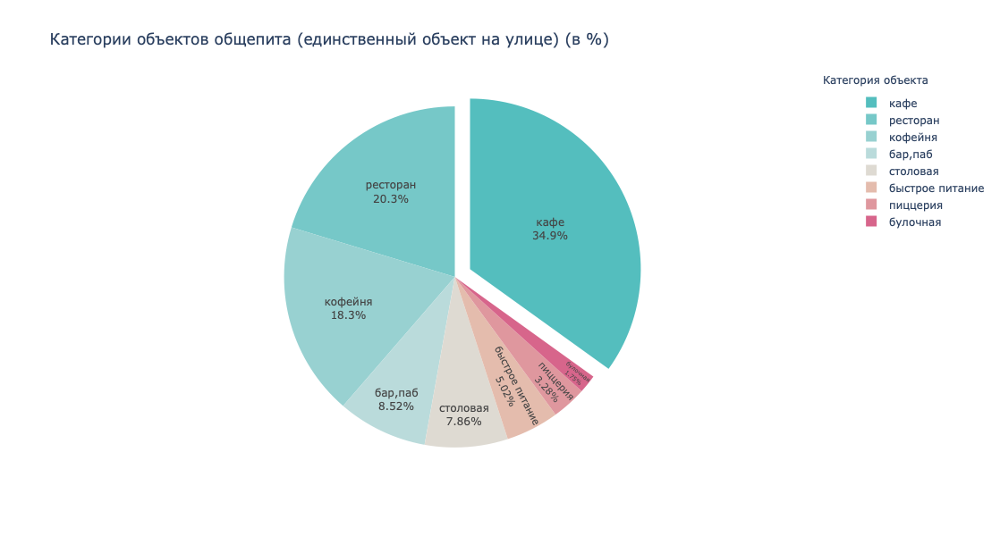

In [125]:
data_by_cat_1str = pd.DataFrame(data_1_street['category'].value_counts()).reset_index()

# строим диаграмму с сегментами
fig = go.Figure(data=[go.Pie(labels=data_by_cat_1str['category'], # указываем значения, которые появятся на метках сегментов
                             values=data_by_cat_1str['count'], # указываем данные, которые отобразятся на графике 
                             pull = [0.1, 0])])

fig.update_layout(title='Категории объектов общепита (единственный объект на улице) (в %)', # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=600,
                  annotations=[dict(x=1.12, # вручную настраиваем аннотацию легенды
                                    y=1.05,
                                    text='Категория объекта',
                                    showarrow=False)])
fig.update_traces(textposition='inside', textinfo='percent+label', marker=dict(colors=colors_fr))
fig.show() # выводим график

35% объектов, которые являются единственными объектами общепита на улице - это кафе, 20% - рестораны, 18% - кофейни.

Посчитаем медианные рейтинг и количество посадочных мест:

In [128]:
data_1_street_medianr=data_1_street['rating'].median()
print(f'Медианный рейтинг: {data_1_street_medianr}')
data_1_street_seats=data_1_street[data_1_street['seats']!= -999]
data_1_street_medians=data_1_street_seats['seats'].median()
print(f'Медианное количество посадочных мест: {data_1_street_medians}')

Медианный рейтинг: 4.3
Медианное количество посадочных мест: 45.0


Посмотрим на распределение заведений по районам:

In [130]:
data_1_street_district=data_1_street.groupby('district').agg(count=('name', 'count')).sort_values(by='count', ascending=False).reset_index()
data_1_street_district['share']=round((data_1_street_district['count']/data_1_street_district['count'].sum()*100), 1)
data_1_street_district

,district,count,share
0,Центральный административный округ,145,31.7
1,Северо-Восточный административный округ,55,12.0
2,Восточный административный округ,52,11.4
3,Северный административный округ,52,11.4
4,Южный административный округ,43,9.4
5,Юго-Восточный административный округ,39,8.5
6,Западный административный округ,35,7.6
7,Северо-Западный административный округ,19,4.1
8,Юго-Западный административный округ,18,3.9


32% объектов, которые являются единственными объектами общепита на улице, находятся в ЦАО, 12% - в СВАО, 11% - в ВАО и столько же в САО.

Построим карту, отображающую единственные заведения на улице:

In [ ]:
# создаём карту Москвы
m_one = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m_one)

def create_clusters(row):
    # сохраняем URL-адрес изображения со значком торгового центра с icons8,
    # это путь к файлу на сервере icons8
    icon_url = 'https://img.icons8.com/?size=512&id=611&format=png'  
    # создаём объект с собственной иконкой размером 30x30
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    # создаём маркер с иконкой icon и добавляем его в кластер
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
        icon=icon,
    ).add_to(marker_cluster)

# применяем функцию для создания кластеров к каждой строке датафрейма
data_1_street.apply(create_clusters, axis=1)

# выводим карту
m_one

Смотря на карту, можно сделать вывод, что если заведение является единственным на улице, то скорее всего оно находится в небольшом переулке или на недлинной улице.

**Вывод**

Количество улиц, на которых находится только один объект общепита: 458, что составляет 31.6% от общего числа улиц в датасете.

Чаще всего это заведения, расположенные на небольших улицах или в переулках.

Данные объекты общественного питания характеризуются следующими признаками:
- В основном это несетевые заведения - 71% (325 об.). Сетевые заведения составляют 29% (133 об.)
- Топ-3 категории: кафе - 35% объектов, 20% - рестораны, 18% - кофейни.
- Медианный рейтинг: 4.3
- Медианное количество посадочных мест: 45.0
- Топ-3 района, в которых данные заведения располагаются: 32% - ЦАО, 12% - в СВАО, 11% - в ВАО и столько же в САО.

### Построение фоновой картограммы (хороплет) со значением ценового индикатора каждого района Москвы

Построим фоновую картограмму (хороплет) с медианным значением столбца middle_avg_bill (примерная стоимость заказа в рублях) для каждого района:

In [138]:
#подготовим данные
avg_bill_data = data[data['middle_avg_bill']!= -999] #убираем заглушку
avg_bill_data = avg_bill_data.groupby('district', as_index=False)['middle_avg_bill'].agg('median')
#avg_bill_data.sort_values(by='middle_avg_bill', ascending=False)

In [ ]:
# создаём карту
m_avg_bill = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=avg_bill_data,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='Oranges',
    fill_opacity=0.8,
    legend_name='Медианная стоимость заказа по районам',
).add_to(m_avg_bill)

# выводим карту
m_avg_bill

**Вывод:**

Из построенной фоновой картограммы мы видим, что самая высокая медианная стоимость заказа - в районах ЦАО и ЗАО (1000 р.), самая низкая - в ЮВАО (450 р.) 
В целом можно сделать вывод о том, что чем дальше от центра, тем медианная стоимость заказа становится ниже.

### Вывод по исследовательскому анализу данных

Проведя исследовательский анализ данных заведений общественного питания Москвы, можно сделать следующие выводы:

1) По категориям объекты общественного питания Москвы делятся следующим образом:
- "кафе" - 2378 об. (28,3%),
- "ресторан" - 2043 об. (24,3%),
- "кофейня"- 1413 об. (16,8%),
- "бар,паб" - 765 об. (9,1%)
- "пиццерия" - 633 об.(7,53%)
- последние три места по количеству объектов занимают категории быстрое питание (7%), столовая (3,7%), булочная (3%).

2) По количеству посадочных мест объекты общественного питания Москвы делятся следующим образом:

Тройка лидеров по количеству посадочных мест выглядит так:
- в категории "ресторан" всего 154 869 посадочных мест
- кафе насчитывают 118770 мест
- в кофейнях всего 83511 посадочных места
Меньше всего посадочных мест в категориях быстрое питание, столовая, булочная.

По медианному количеству посадочных мест:
- самое большое медианное количество посадочных мест наблюдается в категории "ресторан" - 86 мест.
- далее идет категория "бар, паб" - 82,5 мест.
- на третьем месте категория "кофейня" с 80 посадочными местами.

Категория кафе со второго места опустилась на шестое - медианное количество посадочных мест на заведение - 60.

Самое низкое медианное число посадочных мест в категориях "пиццерия" и "булочная".


3) Соотношение сетевых и несетевых объектов общественного питания Москвы выглядит так:
- в датасете больше несетевых заведений - 5201 или 62%, против 38% (3205 об.) сетевых заведений.
- по количеству объектов в датафрейме больше всего сетевых заведений в категориях кафе (779 об.), ресторан (730 об.), кофейня (720 об.).
- самая большая доля сетевых заведений наблюдается в категории "булочная" - сетевые заведения составляют 61% от всех заведений.
- далее идут пиццерии - 52% являются сетевыми
- 51% от всех кофеен в датафрейме - сетевые. третье место
- меньше всего сетевых заведений в категориях "кафе" (32%), "столовая" (28%), "бар, паб" (22%).


4) В топ-15 популярных сетей в Москве (по количеству заведений сети) входят крупные и известные сети, такие как: 'Шоколадница', "Домино'с Пицца", 'Додо Пицца', 'One Price Coffee', 'Яндекс Лавка', 'Cofix', 'Prime', 'Хинкальная', 'КОФЕПОРТ', 'Кулинарная лавка братьев Караваевых', 'Теремок', 'Чайхана', 'CofeFest', 'Буханка', 'Му-Му'.

Самые популярные категории, характерные для топ-15 (по количеству точек) сетевых заведений Москвы, такие:
- кофейня (336 объектов)
- ресторан (186 об.)
- пиццерия (151 об.)
- кафе (100 об.)

5) По количеству заведений по районам Москвы разделение выглядит следующим образом:

Больше всего заведений находится в ЦАО - 2242 объекта (26,7%), далее идут 4 района с примерно одинаковым количеством объектов (в районе 10-11% от всех) - САО, ЮАО, СВАО, ЗАО. Меньше всего объектов находится в СЗАО - всего 409 (4,9%).

Распределение категорий заведений по районам примерно одинаково:
- на первых трех местах стабильно находятся категории кафе, ресторан и кофейня.
- рестораны занимают первое место по количеству только в районе ЦАО. В других районах на первых местах чаще заведения категории кафе.
- кофейни во всех районах занимают третье место по количеству точек.


6) Распределение средних рейтингов по категориям заведений:

Усредненный рейтинг по разным типах общепита не сильно отличается - от 4,4 у баров/пабов до 4,1 у быстрого питания.

По графикам boxplot лучше всех себя показывают заведения категории "бар, паб", заведения других категорий - "ресторан", "кафе", "кофейня", "пиццерия", "булочная" - показывают примерно одинаковые результаты. Хуже других распределение рейтинга у заведений категорий "быстрое питание" и "столовая."

7) Самый высокий медианный рейтинг - у заведений в центре Москвы (4,4 балла). Самый низкий - у объектов, находящихся в СВАО и ЮВАО (4,2 балла). У заведений в остальных районах медианный рейтинг примерно одинаков и составляет 4,3 балла.

8) В топ-15 популярных улиц Москвы входят крупные магистрали и шоссе, пронизывающие все районы города.

- Самое большое количество объектов (184) находится на проспекте Мира.
- Далее идут длинные и популярные улицы - Профсоюзная улица (122 об.), проспект Вернадского (108 об.), Ленинский проспект (107 об.), Ленинградский проспект (95 об.).
- Замыкает топ-15 лидеров Пятницкая улица (48 объектов).

9) Распределение категорий заведений на топ-15 популярных улицах Москвы:
- Кафе наиболее популярны на топ-15 улицах Москвы (всего 353 об.): больше всего их на проспекте Мира (53 об.), далее идут МКАД (45 об.), Профсоюзная улица (35 об.).
- Потом идет категория рестораны (всего 327 об.) - больше всего ресторанов находится на улицах проспект Мира (45 об.), Ленинский проспект (33 об.), проспект Вернадского (33 об.).
- На третьем месте находятся кофейни (220 об.) - проспект Мира (36 об.), Ленинградский проспект (25 об.), Ленинский проспект (23 об.).
- Меньше всего на топ-15 улицах Москвы открыто столовых (40 об.) и булочных (26 об.).

10) Количество улиц, на которых находится только один объект общепита: 458, что составляет 31.6% от общего числа улиц в датасете. Чаще всего это заведения, расположенные на небольших улицах или в переулках.

11) Cамая высокая медианная стоимость заказа - в районах ЦАО и ЗАО (1000 р.), самая низкая - в ЮВАО (450 р.) В целом можно сделать вывод о том, что чем дальше от центра, тем медианная стоимость заказа становится ниже.

## Детализированное исследование данных: открытие кофейни

Основателям фонда «Shut Up and Take My Money» не даёт покоя успех сериала «Друзья». Их мечта — открыть такую же крутую и доступную, как «Central Perk», кофейню в Москве.

Ответим на вопросы инвесторов:

### Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?

In [146]:
#сначала подготовим данные
data_coffeehouse=data[data['category']=='кофейня']
data_coffeehouse=pd.concat([data_coffeehouse], ignore_index=True)

In [147]:
print(f'Всего кофеен в датасете: {len(data_coffeehouse)}')

Всего кофеен в датасете: 1413


In [148]:
data_coffeehouse_by_district = data_coffeehouse.groupby('district').agg(count=('name', 'count')).sort_values(by='count', ascending=False)
data_coffeehouse_by_district['share']=round(data_coffeehouse_by_district['count']/sum(data_coffeehouse_by_district['count'])*100, 1)
data_coffeehouse_by_district=data_coffeehouse_by_district.reset_index()
print('Распределение кофеен по районам Москвы:')
data_coffeehouse_by_district

Распределение кофеен по районам Москвы:


,district,count,share
0,Центральный административный округ,428,30.3
1,Северный административный округ,193,13.7
2,Северо-Восточный административный округ,159,11.3
3,Западный административный округ,150,10.6
4,Южный административный округ,131,9.3
5,Восточный административный округ,105,7.4
6,Юго-Западный административный округ,96,6.8
7,Юго-Восточный административный округ,89,6.3
8,Северо-Западный административный округ,62,4.4


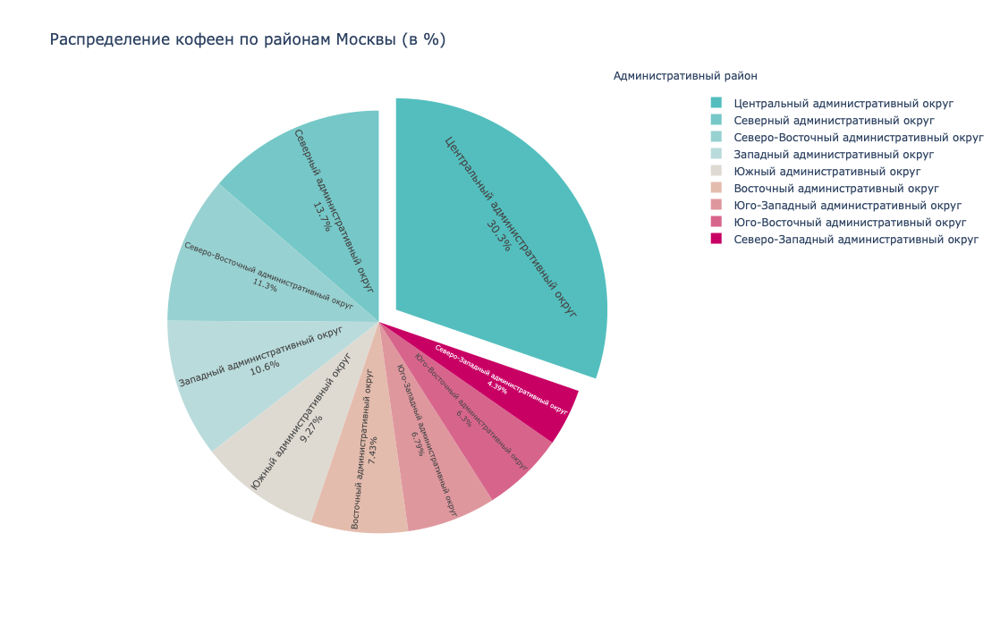

In [149]:
# строим диаграмму с сегментами
fig = go.Figure(data=[go.Pie(labels=data_coffeehouse_by_district['district'], # указываем значения, которые появятся на метках сегментов
                             values=data_coffeehouse_by_district['count'], # указываем данные, которые отобразятся на графике 
                             pull = [0.1, 0])])

fig.update_layout(title='Распределение кофеен по районам Москвы (в %)', # указываем заголовок графика
                  width=900, # указываем размеры графика
                  height=700,
                  annotations=[dict(x=1.12, # вручную настраиваем аннотацию легенды
                                    y=1.05,
                                    text='Административный район',
                                    showarrow=False)])
fig.update_traces(textposition='inside', textinfo='percent+label', marker=dict(colors=colors_fr))
fig.show() # выводим график

Построим карту с указанием всех кофеен:

In [ ]:
# создаём карту Москвы
m_coffeehouse = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m_coffeehouse)

def create_clusters(row):
    # сохраняем URL-адрес изображения со значком торгового центра с icons8,
    # это путь к файлу на сервере icons8
    icon_url = 'https://img.icons8.com/?size=512&id=nqqkFQrmhH3e&format=png'  
    # создаём объект с собственной иконкой размером 30x30
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    # создаём маркер с иконкой icon и добавляем его в кластер
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
        icon=icon,
    ).add_to(marker_cluster)

# применяем функцию для создания кластеров к каждой строке датафрейма
data_coffeehouse.apply(create_clusters, axis=1)

# выводим карту
m_coffeehouse

**Вывод**

В датасете всего присутствует 1413 кофеен.

Больше всего кофеен находится в ЦАО - 428 об. (30%), далее идет САО - 193 об. (13,7%), на третьем месте СВАО - 159 об.(11%). Меньше всего кофеен в СЗАО - всего 62 об. (4%).

Посмотрев на карту с распределением кофеен по Москве можно сделать вывод, что в основном они располагаются либо на либо вблизи крупных, проходимых улиц, рядом с транспортными объектами (станции метро, вокзалы), рядом с культурными или образовательными учреждениями, парками.

### Есть ли круглосуточные кофейни?

In [154]:
data_coffeehouse_24 = pd.DataFrame(data_coffeehouse['is_24/7'].value_counts()).reset_index()
data_coffeehouse_24_true=data_coffeehouse_24.iloc[1]['is_24/7']

print(f'Количество круглосуточных кофеен в датасете: {data_coffeehouse_24_true}')

Количество круглосуточных кофеен в датасете: True


In [155]:
data_coffeehouse_24_by_district=data_coffeehouse[data_coffeehouse['is_24/7']==True]
data_coffeehouse_24_by_district=data_coffeehouse_24_by_district.groupby('district').agg(count=('name', 'count')).sort_values(by='count', ascending=False)
data_coffeehouse_24_by_district['share']=round(data_coffeehouse_24_by_district['count']/sum(data_coffeehouse_24_by_district['count'])*100, 1)
data_coffeehouse_24_by_district=data_coffeehouse_24_by_district.reset_index()
print('Распределение круглосуточных кофеен по районам Москвы:')
data_coffeehouse_24_by_district

Распределение круглосуточных кофеен по районам Москвы:


,district,count,share
0,Центральный административный округ,26,44.1
1,Западный административный округ,9,15.3
2,Юго-Западный административный округ,7,11.9
3,Восточный административный округ,5,8.5
4,Северный административный округ,5,8.5
5,Северо-Восточный административный округ,3,5.1
6,Северо-Западный административный округ,2,3.4
7,Юго-Восточный административный округ,1,1.7
8,Южный административный округ,1,1.7


In [156]:
data_coffeehouse_24_by_name = data_coffeehouse[data_coffeehouse['is_24/7']==True]
data_coffeehouse_24_by_name=pd.DataFrame(data_coffeehouse_24_by_name['name'].value_counts()).reset_index()
print('Группировка круглосуточных кофеен по названиям (первые 5):')
data_coffeehouse_24_by_name.head()

Группировка круглосуточных кофеен по названиям (первые 5):


,name,count
0,шоколадница,17
1,кофемания,8
2,wild bean cafe,6
3,wild bean,5
4,кофе хауз,3


In [157]:
data_coffeehouse_24_by_chain = data_coffeehouse[data_coffeehouse['is_24/7']==True]
data_coffeehouse_24_by_chain = pd.DataFrame(data_coffeehouse_24_by_chain['chain'].value_counts())
print('Распределение круглосуточных кофеен по признаку сетевые/несетевые:')
data_coffeehouse_24_by_chain

Распределение круглосуточных кофеен по признаку сетевые/несетевые:


,count
chain,
1,50
0,9


**Вывод**

В датасете присутствует 59 кофеен, работающих круглосуточно. В основном это сетевые заведения (50 об.).

Основная их часть находится в ЦАО - 26 об. (44%), далее идет ЗАО - 9 об.(15%), за ним ЮЗАО - 7 об.(12%).

Больше всего круглосуточных кофеен сети Шоколадница - 17 об., далее идет Кофемания (8 об.), следом Wild Bean Cafe (6 об.).

### Какие у кофеен рейтинги? Как они распределяются по районам?

Построим гистограмму распределения рейтинга среди кофеен:

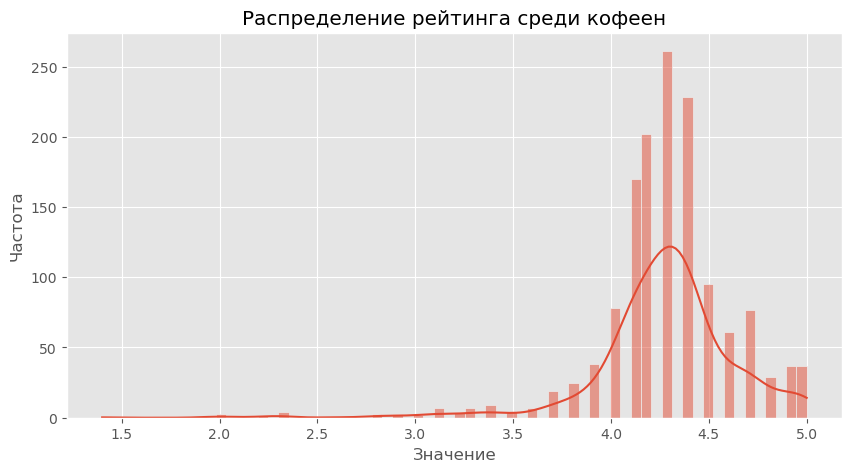

In [161]:
plt.figure(figsize=(10,5))
# строим гистограмму, добавив график кривой KDE
sns.histplot(x='rating', data=data_coffeehouse, kde=True)
# указываем заголовок графика и подписи осей
plt.title('Распределение рейтинга среди кофеен')
plt.xlabel('Значение')
plt.ylabel('Частота')
# отображаем график на экране
plt.show()

In [162]:
data_coffeehouse_rating=data_coffeehouse['rating'].median()
print(f'Медианный рейтинг кофеен: {data_coffeehouse_rating}')

Медианный рейтинг кофеен: 4.3


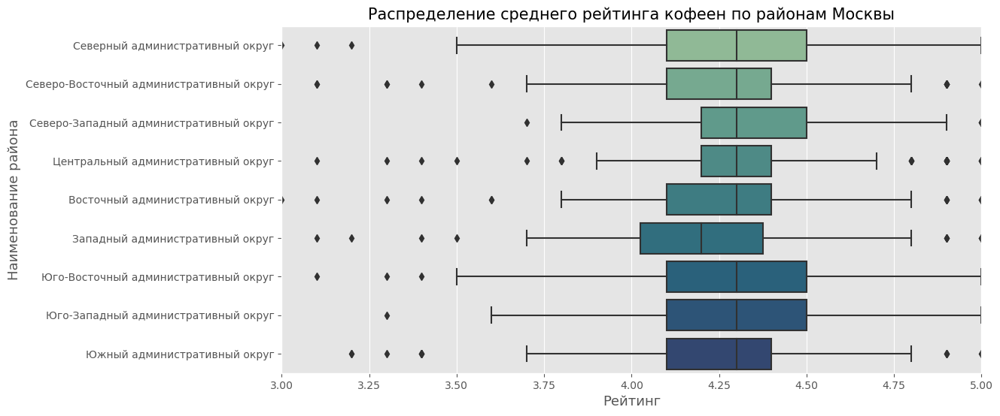

In [163]:
plt.figure(figsize=(12,6))
df5 = sns.boxplot(data=data_coffeehouse, x='rating', y='district', palette='crest')
df5.set(xlim=(3,5))
plt.title('Распределение среднего рейтинга кофеен по районам Москвы', size = 15)
plt.xlabel('Рейтинг', size = 13)
plt.ylabel('Наименование района', size = 13)
plt.show()

**Вывод**

Медианный рейтинг кофеен в датасете: 4.3.

По графику boxplot лучше всего распределение рейтинга у кофеен, находящихся в САО, СЗАО, ЦАО, ЮВАО, ЮЗАО. Хуже других распределение среднего рейтинга у кофеен в ЗАО.

### На какую стоимость чашки капучино стоит ориентироваться при открытии?

Построим график распределения стоимости чашки капучино среди кофеен:

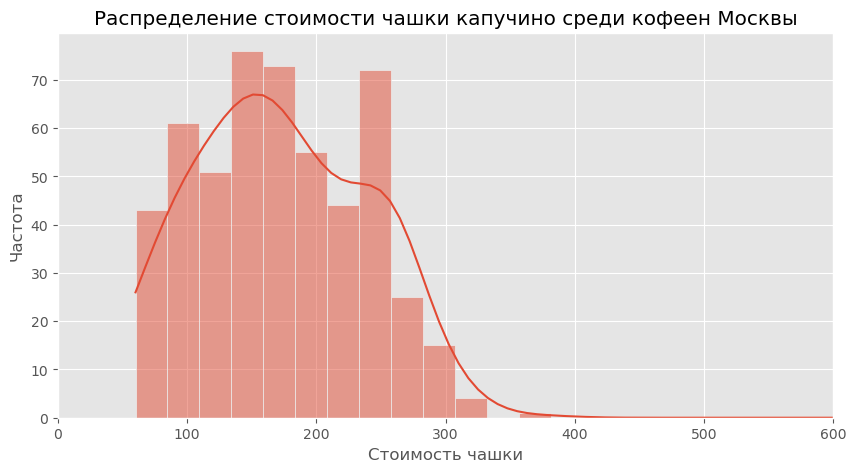

In [167]:
#подготовим данные
data_coffeehouse_cup=data_coffeehouse[data_coffeehouse['middle_coffee_cup']!=-999]

plt.figure(figsize=(10,5))
# строим гистограмму, добавив график кривой KDE
sns.histplot(x='middle_coffee_cup', data=data_coffeehouse_cup, kde=True)
# ограничиваем ось X для наглядности
plt.xlim(0, 600)
# указываем заголовок графика и подписи осей
plt.title('Распределение стоимости чашки капучино среди кофеен Москвы')
plt.xlabel('Стоимость чашки')
plt.ylabel('Частота')
# отображаем график на экране
plt.show()

Стоимость чашки капучино среди кофеен в датасете варьируется от 90 до 300 руб.

In [169]:
data_coffeehouse_cup_med=data_coffeehouse_cup['middle_coffee_cup'].median()
print(f'Медианная стоимость чашки капучино в кофейнях Москвы: {data_coffeehouse_cup_med}')

Медианная стоимость чашки капучино в кофейнях Москвы: 170.0


Важно отметить, что ценообразование должно определяться на основе глубокого понимания целевого рынка и местной кофейной индустрии. При установлении цен следует учитывать такие факторы, как качество кофе, атмосфера, обслуживание и уникальные предложения. 

Кроме того, важно проанализировать ценовую стратегию конкурентов, что может дать представление о рыночных нормах и помочь правильно позиционировать свою кофейню.

Проведем анализ медианной стоимости кашки капучино по районам Москвы:

In [171]:
data_coffeehouse_cup_by_district=data_coffeehouse_cup.groupby('district').agg(median=('middle_coffee_cup', 'median')).sort_values(by='median', ascending=False)
data_coffeehouse_cup_by_district=data_coffeehouse_cup_by_district.reset_index()
#print('Медианная стоимость чашки капучино по районам Москвы:')
#data_coffeehouse_cup_by_district

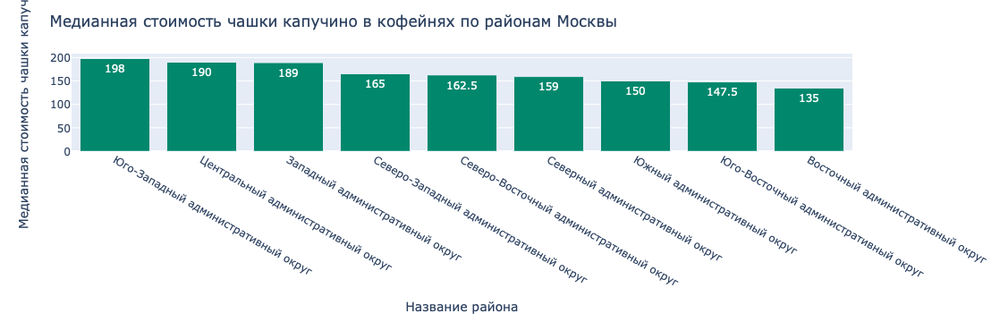

In [172]:
# строим столбчатую диаграмму 
fig = px.bar(data_coffeehouse_cup_by_district, # загружаем данные
             x='district', # указываем столбец с данными для оси X
             y='median', # указываем столбец с данными для оси Y
             color_discrete_sequence=colors3,
             text='median'
            )
# оформляем график
fig.update_layout(title='Медианная стоимость чашки капучино в кофейнях по районам Москвы',
                  xaxis_title='Название района',
                  yaxis_title='Медианная стоимость чашки капучино',
                  showlegend=False)

fig.show() # выводим график

Также рассчитаем медианный чек в кофейнях по районам:

In [174]:
data_coffeehouse_bill=data_coffeehouse[data_coffeehouse['middle_avg_bill']!=-999]
data_coffeehouse_bill_by_district=data_coffeehouse_bill.groupby('district').agg(median=('middle_avg_bill', 'median')).sort_values(by='median', ascending=False)
data_coffeehouse_bill_by_district=data_coffeehouse_bill_by_district.reset_index()
print('Медианный средний чек в кофейнях по районам Москвы:')
data_coffeehouse_bill_by_district

Медианный средний чек в кофейнях по районам Москвы:


,district,median
0,Западный административный округ,600.0
1,Центральный административный округ,500.0
2,Восточный административный округ,400.0
3,Южный административный округ,387.5
4,Юго-Западный административный округ,375.0
5,Северный административный округ,325.0
6,Северо-Восточный административный округ,325.0
7,Северо-Западный административный округ,325.0
8,Юго-Восточный административный округ,250.0


In [175]:
data_coffeehouse_bill_med=data_coffeehouse_bill['middle_avg_bill'].median()
print(f'Медианный чек в кофейнях Москвы: {data_coffeehouse_bill_med}')

Медианный чек в кофейнях Москвы: 400.0


**Вывод**

Медианная стоимость чашки капучино по Москве составляет 170 руб.
Медианный средний чек в кофейнях Москвы составляет 400 руб.

При открытии кофейни стоит ориентироваться также на медианную стоимость чашки капучино и средний чек в планируемом районе открытия кофейни для правильного позиционирования своей кофейни и соответствия ее рыночным нормам.

### Рекомендации для открытия нового заведения

Дадим несколько рекомендаций для открытия кофейни в стиле кофейни "Central Perk" из сериала "Друзья" в Москве:

1) Расположение: 

Расположение кофейни имеет решающее значение.

Кофейня в стиле "Central Perk" предполагает формат отдельно стоящей кофейни с посадкой без кухни - заведения с отдельным входом с улицы и небольшим посадочным залом. В ассортименте помимо кофе могут быть замороженные десерты и сэндвичи, которые разогревают на баре. 

Стоит рассмотреть возможность открытия кофейни в районе с высокой интенсивностью пешеходного движения и легкодоступным общественным транспортом. Лучше всего для этих целей подойдет район ЦАО - район, который привлекает как местных жителей, так и туристов.

Нужно найти место рядом с популярным торговым районом, культурным центром или районом рядом с университетами или офисными комплексами.

2) Ценовая политика:

Ценовая политика должна быть доступной, но не в ущерб качеству продукта.

- Медианная стоимость чашки капучино в ЦАО составляет 190 руб. Стоит ориентироваться на эту конкурентноспособную цену, соответствующую рыночным нормам.
- Медианный средний чек в кофейнях ЦАО составляет 500 руб., эту информацию также стоит учитывать при разработке меню.

3) Разработка меню:

Необходимо разработать меню, которое предлагает различные варианты кофе, включая традиционные фавориты, такие как капучино, латте и эспрессо. А также добавить напитки с названиями, связанными с шоу "Друзья", например:
- "Central Perk Special" - фирменная кофейная смесь с оттенком карамели и взбитых сливок сверху.
- "Smelly Cat Latte" - ванильный латте с оттенком корицы.
- "Ross' Mocha Madness" - насыщенный мокко с добавлением орехового сиропа.
- "Phoebe's Caramel Smiles" - карамельный макиато с капелькой шоколадного сиропа.
- "Joey's Espresso Kick" - двойная порция эспрессо с щепоткой корицы и ложкой взбитых сливок.
- "Monica's Minty Delight" - освежающий мокко с перечной мятой, посыпанный шоколадной стружкой.
- "Rachel's Raspberry Dream" - малиновый латте из белого шоколада с малиновым сиропом.
- "Chandler's Cinnamon Surprise" - латте с корицей, нотками мускатного ореха и порошком корицы.
- "Gunther's Vanilla Bliss" - классический ванильный латте с оттенком миндального вкуса.

4) Разработка дизайна интерьера:

Большую роль при открытии кофейни, вдохновленной кофейней "Central Perk" из сериала "Друзья", является создание удобного и гостеприимного пространства для клиентов, чтобы они могли расслабиться и пообщаться. Необходимо включить такие элементы, как винтажная мебель, декор, связанный с кофе, и памятные вещи, вдохновленные шоу: характерный оранжевый диван, кирпичные стены, меню на доске и другие знаковые детали.

Также можно рассмотреть возможность включения живой музыки или вечеров с открытым микрофоном, подобных выступлениям, которые часто проходили в Central Perk. Это может помочь создать живую и привлекательную атмосферу для клиентов.

Принимая во внимание эти факторы и уделив внимание тщательному финансовому планированию, маркетингу и разработке меню, можно увеличить шансы на успех в открытии своей кофейни в Москве.